# The Effects of COVID-19 on a County, State, and Socioeconomic Level


## Authors: Eric Wang, Flora Dong, Jinwei Zhang

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.express as px
import plotly.subplots as ps
import plotly.graph_objects as go
import sys

In [2]:
# Set to true to see debug statements and dataframe previews.
VERBOSE = True

# We should be extra cautious about inf values.
pd.options.mode.use_inf_as_na = True

## Project Guidelines
1. Perform exploratory data analysis (EDA) and include in your report at least two data visualizations.
2. Describe any data cleaning or transformations that you perform and why they are motivated by your
EDA.
3. Apply relevant inference or prediction methods (e.g., linear regression, logistic regression, or classification and regression trees), including, if appropriate, feature engineering and regularization.
4. Use cross-validation or test data as appropriate for model selection and evaluation. Make sure to
carefully describe the methods you are using and why they are appropriate for the question to be
answered.
5. Summarize and interpret your results (including visualization).
6. Provide an evaluation of your approach and discuss any limitations of the methods you used.
7. Describe any surprising discoveries that you made and future work.

In [3]:
states = counties = time_deaths = time_confirmed = state_abbreviations = svi = None
def load_data_frames():
    """Loads all of the DataFrames into their respective global variables
    
    Warning, this will overwrite any changes made to the DataFrames.
    """
    global states, counties, time_deaths, time_confirmed, state_abbreviations, svi
    states, counties, time_deaths, time_confirmed, state_abbreviations, svi = load_private_data_frames()

def loadDataFrames():
    """returns load_data_frames()
    
    This is for backwards compatibility before the swap to PEP8 naming conventions."""
    print("Depreciated. Please use load_data_frames() instead.")
    return load_data_frames()

def load_private_data_frames():
    """Loads all of the DataFrames and returns them in the order 0: states, 1: counties, 2: time_deaths, 3: time_confirmed, 4: state_abbreviations, 5: svi
    
    This does not override global variables."""
    states = pd.read_csv("4.18states.csv")
    counties = pd.read_csv("abridged_couties.csv")
    time_deaths = pd.read_csv("time_series_covid19_deaths_US.csv")
    time_confirmed = pd.read_csv("time_series_covid19_confirmed_US.csv")
    # state_abbreviations is a custom dataset mapping state names to their abbreviations.
    # source can be found here: https://github.com/jasonong/List-of-US-States/blob/master/states.csv
    state_abbreviations = pd.read_csv("stateAbbreviations.csv")
    # 2018 CDC SVI Data
    # Source: https://svi.cdc.gov/data-and-tools-download.html
    svi = pd.read_csv("SVI2018_US_COUNTY.csv")
    return states, counties, time_deaths, time_confirmed, state_abbreviations, svi


## EDA - Exploratory Data Analysis
1. How does the population density and isolation of a rural town vs. a city impact their use of social distancing / shelter at home requirements? How has this impacted their infection rates?

2. What role does socioeconomic status play in the ability to recover from cases of COVID-19? (This is dependent on getting a supplementary dataset to show wealth or finding a column that I have not yet found in our dataset so maybe not. But I'd be interested!)

3. How have state level approaches towards coronavirus impacted a) number of cases b) recovery rate c) amount of social distancing in comparable counties / cities.

For the purposes of our project, we will limit ourselves to the investigation of conditions within the United States. The reasoning for this is two-fold. First, the US has a vastly different medical system and approach to COVID-19 compared to their counterparts with a national healthcare system, or those without a developed healthcare infrastructure, etc. Second, the data for most of the non-US locations are incomplete. As such, adding them will force us to consider many factors and do a considerable cleanup of the data that is simply not worth our effort. Evidence of the lack of sufficient data can be seen in the table below.

In [4]:
def show_non_us():
    """ returns the counties data frame outside of the US.
    """
    load_data_frames()
    statelookup = state_abbreviations.set_index('Abbreviation')
    return counties[~counties['StateName'].isin(statelookup.index)]

if VERBOSE:
    print(show_non_us())

     countyFIPS  STATEFP  COUNTYFP         CountyName StateName State  lat  \
3142      60010      NaN       NaN            Unknown        AS   NaN  NaN   
3143      60020      NaN       NaN              Manua        AS   NaN  NaN   
3144      60020      NaN       NaN                Ofu        AS   NaN  NaN   
3145      60020      NaN       NaN            Olosega        AS   NaN  NaN   
3146      60050      NaN       NaN            Tutuila        AS   NaN  NaN   
...         ...      ...       ...                ...       ...   ...  ...   
3229      78010      NaN       NaN          St. Croix        VI   NaN  NaN   
3230      78020      NaN       NaN           St. John        VI   NaN  NaN   
3231      78030      NaN       NaN         St. Thomas        VI   NaN  NaN   
3240      72039     72.0      39.0   Ciales Municipio        PR   NaN  NaN   
3241      72069     72.0      69.0  Humacao Municipio        PR   NaN  NaN   

      lon  POP_LATITUDE  POP_LONGITUDE  ... >500 gatherings pub

In [5]:
# Load the data
load_data_frames()

def show_raw_data():
    """ Prints out the raw data provided to us in this project.
    """
    load_data_frames()
    print("states", states.head())
    print("counties", counties.head())
    print("time_deaths", time_deaths.head())
    print("time_confirmed",  time_confirmed.head())
    
# Here you can see the raw data provided to us in this project.
if VERBOSE:
    show_raw_data()

states    Province_State Country_Region          Last_Update      Lat     Long_  \
0         Alabama             US  2020-04-18 22:32:47  32.3182  -86.9023   
1          Alaska             US  2020-04-18 22:32:47  61.3707 -152.4044   
2  American Samoa             US                  NaN -14.2710 -170.1320   
3         Arizona             US  2020-04-18 22:32:47  33.7298 -111.4312   
4        Arkansas             US  2020-04-18 22:32:47  34.9697  -92.3731   

   Confirmed  Deaths  Recovered  Active  FIPS  Incident_Rate  People_Tested  \
0       4712     153        NaN  4559.0   1.0     100.492717        42538.0   
1        314       9      147.0   305.0   2.0      52.530410         9655.0   
2          0       0        NaN     NaN  60.0       0.000000            3.0   
3       4724     180      539.0  4544.0   4.0      64.901548        51045.0   
4       1744      38      703.0  1706.0   5.0      67.361213        24141.0   

   People_Hospitalized  Mortality_Rate       UID ISO3  Testin

### States Dataset

In [6]:
# As stated before, we will be restricting ourselves to US data only. 
# Of the US data we will be dropping ships like the Diamond Princess and Territories like Guam.
# We believe that these ships and territories have a different environment and thus would be unfair to compare.
# Below is a chart of data listed under the US that will be dropped from the table.
# Notice that we chose to drop Recovered as it only provides the total number of recovered cases for the country as a whole which is better saved as single variable than keep in the DF.
if VERBOSE:
    TOTAL_RECOVERED_US = states.at[116, 'Recovered']
    assert TOTAL_RECOVERED_US == 64840.0
    print(states[~states['Province_State'].isin(state_abbreviations['State']) & (states['Country_Region'] == 'US')])

               Province_State Country_Region          Last_Update      Lat  \
2              American Samoa             US                  NaN -14.2710   
9            Diamond Princess             US  2020-04-18 22:32:47      NaN   
13             Grand Princess             US  2020-04-18 22:32:47      NaN   
14                       Guam             US  2020-04-18 22:32:47  13.4443   
39   Northern Mariana Islands             US  2020-04-18 22:32:47  15.0979   
44                Puerto Rico             US  2020-04-18 22:32:47  18.2208   
52             Virgin Islands             US  2020-04-18 22:32:47  18.3358   
116                 Recovered             US                  NaN      NaN   

        Long_  Confirmed  Deaths  Recovered   Active     FIPS  Incident_Rate  \
2   -170.1320          0       0        NaN      NaN     60.0       0.000000   
9         NaN         49       0        0.0     49.0  88888.0            NaN   
13        NaN        103       0        0.0    103.0  999

#### Column Breakdown:
[README for column descriptions](https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data.)

**Not useful:** `UID`, `ISO3`, `Last_Update`(all 4/18 22:34:47), `Country_Region`, `Recovered`, `Active`
- We have restricted our data to the US only so FIPS codes act as an appropriate Primary Key.
- `Recovered` is missing 22 out of 51 of data entries. To draw conclusions from such incomplete data would be unwise. As such, the definition of `Active` is also ambiguous. We choose to remove both columns.

**Out of Scope of our desired research:** `Lat`, `Long_` 
- Location data will force us to consider proximity to outbreaks, population centers, etc that will not be possible with a simple linear regression. A possible approach is using a KNN clustering algorithm to predict based upon neighboring states. However, because our questions are not centered around location and factors to consider such as differing sizes of each state, we conclude that this will detract from our research. Instead of adding an extra feature for the potential of having a better model, we would rather take out the feature to better see how our target features impact our predictions.

**Identifying Keys:** `Province_State` (Human readable), `FIPS` (Primary Key)  
**Numerical Data:** `Confirmed`, `Deaths`, `Incident_Rate`, `People_Tested`, `People_Hospitalized`, `Mortality_Rate`, `Testing_Rate`, `Hospitalization_Rate`  
**Categorical Data:** None


In [7]:
def cleanStates(s):
    """Clean up the States DataFrame
    
    Note that this does NOT change the global states variable.
    We drop columns 'Last_Update', 'Lat', 'Long_', 'Country_Region', 'ISO3', 'UID' because they are not useful to us (either all the same data or out of scope of our are investigation)
    We also filter for only US States (including Washington DC).
    Boats and territories have been removed.
    Moreover, the US Recovered row has also been removed.
    We notice that the Active cases column is not to spec per the README.
    The CSV has Active as Confirmed - Deaths when it should be Confirmed - Deaths - Recovered.
    Details can be found here: https://github.com/CSSEGISandData/COVID-19/issues/2142
    Given that 22 of our states do not have recovered statistics, we decide to drop the column entirely as the data is painfully incomplete.
    Please note that Indiana, Nebraska, and Nevada do not have Hospitalization rates.
    
    README for column descriptions: https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data.
    """
    cols_to_drop_states = ['Last_Update', 'Lat', 'Long_', 'Recovered', 'Country_Region', 'ISO3', 'UID']
    try:
        s = s.drop(columns = cols_to_drop_states)
    except KeyError:
        print('states is missing a column. Proceed with caution.')
        s = s.drop(columns = cols_to_drop_states, errors='ignore')
    s = s[s['Province_State'].isin(state_abbreviations['State'])]
    return s

def clean_states(s=states):
    return cleanStates(s)

if type(states) != None:
    states = clean_states()

if VERBOSE:
    print(states)

          Province_State  Confirmed  Deaths    Active  FIPS  Incident_Rate  \
0                Alabama       4712     153    4559.0   1.0     100.492717   
1                 Alaska        314       9     305.0   2.0      52.530410   
3                Arizona       4724     180    4544.0   4.0      64.901548   
4               Arkansas       1744      38    1706.0   5.0      67.361213   
5             California      30491    1140   29351.0   6.0      77.766063   
6               Colorado       9047     389    8658.0   8.0     159.648818   
7            Connecticut      17550    1086   16464.0   9.0     492.246487   
8               Delaware       2538      67    2471.0  10.0     260.638101   
10  District of Columbia       2666      91    2575.0  11.0     377.754697   
11               Florida      25492     748   24744.0  12.0     120.060628   
12               Georgia      17669     673   16996.0  13.0     174.260925   
15                Hawaii        574       9     565.0  15.0     

In [8]:
# Here is an overview of missing data after data cleaning. 
# As you can see, Indiana, Nebraska, and Nevada do not have Hospitalization rates.
# We decided that this was okay as they have statistics for everything else and it would be important to not disregard them.
# However, we also elect not to fill these statistics in as we have no way of producing an accurate guess.
# Possible steps in the future would be to see if those states have released any data retroactively.
# We would like to caution against using data that is not timestamped for 4/18/20 as it reflects the status of these States at a later time where the number of cases and available hospitals may be different.
if VERBOSE:
    pd.set_option('display.max_rows', None)
    print(len(states) - states.count())
    pd.set_option('display.max_rows', 10)
    print(states[states['People_Hospitalized'].isnull()])


Province_State          0
Confirmed               0
Deaths                  0
Active                  0
FIPS                    0
Incident_Rate           0
People_Tested           0
People_Hospitalized     3
Mortality_Rate          0
Testing_Rate            0
Hospitalization_Rate    3
dtype: int64
   Province_State  Confirmed  Deaths   Active  FIPS  Incident_Rate  \
18        Indiana      10641     545  10096.0  18.0     162.607117   
31       Nebraska       1249      24   1225.0  31.0      81.887034   
32         Nevada       3626     151   3475.0  32.0     120.197686   

    People_Tested  People_Hospitalized  Mortality_Rate  Testing_Rate  \
18        56873.0                  NaN        5.121699    869.086983   
31        13677.0                  NaN        1.921537    896.692524   
32        30751.0                  NaN        4.164368   1019.359916   

    Hospitalization_Rate  
18                   NaN  
31                   NaN  
32                   NaN  


#### Counties Dataset
[ReadMe for column descriptions.](https://github.com/Yu-Group/covid19-severity-prediction/blob/master/data/list_of_columns.md)
Please note that we are using the abridged dataset from 4/18/20.  

**Not useful:** 

**Out of Scope of our desired research:** `lat`, `lon`, `POP_LATITUDE`, `POP_LONGITUDE`  
- As reasoned in the States Dataset, we chose to not include location data.

**Identifying Keys:** `countyFIPS`, `STATEFP`, `CountyName`, `StateFull`  
**Numerical Data:** `PopulationEstimate2018`,
`PopTotalMale2017`, `PopTotalFemale2017`, `FracMale2017`,
`PopulationEstimate65+2017`, `PopulationDensityperSqMile2010`,
`CensusPopulation2010`, `MedianAge2010`, `#EligibleforMedicare2018`,
`MedicareEnrollment,AgedTot2017`, `3-YrDiabetes2015-17`,
`DiabetesPercentage`, `HeartDiseaseMortality`, `StrokeMortality`,
`Smokers_Percentage`, `RespMortalityRate2014`, `#FTEHospitalTotal2017`,
`TotalM.D.'s,TotNon-FedandFed2017`, `#HospParticipatinginNetwork2017`,
`#Hospitals`, `#ICU_beds`, `dem_to_rep_ratio`, `PopMale<52010`,
`PopFmle<52010`, `PopMale5-92010`, `PopFmle5-92010`, `PopMale10-142010`,
`PopFmle10-142010`, `PopMale15-192010`, `PopFmle15-192010`,
`PopMale20-242010`, `PopFmle20-242010`, `PopMale25-292010`,
`PopFmle25-292010`, `PopMale30-342010`, `PopFmle30-342010`,
`PopMale35-442010`, `PopFmle35-442010`, `PopMale45-542010`,
`PopFmle45-542010`, `PopMale55-592010`, `PopFmle55-592010`,
`PopMale60-642010`, `PopFmle60-642010`, `PopMale65-742010`,
`PopFmle65-742010`, `PopMale75-842010`, `PopFmle75-842010`,
`PopMale>842010`, `PopFmle>842010`, `3-YrMortalityAge<1Year2015-17`,
`3-YrMortalityAge1-4Years2015-17`, `3-YrMortalityAge5-14Years2015-17`,
`3-YrMortalityAge15-24Years2015-17`,
`3-YrMortalityAge25-34Years2015-17`,
`3-YrMortalityAge35-44Years2015-17`,
`3-YrMortalityAge45-54Years2015-17`,
`3-YrMortalityAge55-64Years2015-17`,
`3-YrMortalityAge65-74Years2015-17`,
`3-YrMortalityAge75-84Years2015-17`, `3-YrMortalityAge85+Years2015-17`,
`mortality2015-17Estimated`, `stay at home`, `>50 gatherings`,
`>500 gatherings`, `public schools`, `restaurant dine-in`,
`entertainment/gym`, `federal guidelines`, `foreign travel ban`,
`SVIPercentile`, `HPSAShortage`, `HPSAServedPop`, `HPSAUnderservedPop`

**Categorical Data:** `CensusRegionName`, `CensusDivisionName`, `Rural-UrbanContinuumCode2013`
- Different from the Latitude, Longitude data that we have decided to omit, we chose to include Census Regions and Divisions under the assumption that the folks over at the US Census Beureu had a good reason for placing counties in their respective categories. We can hope that these reasons carry through to modeling the pandemic.  

**Timestamp Data:** `stay at home_ts`, `>50 gatherings_ts`,
`>500 gatherings_ts`, `public schools_ts`, `restaurant dine-in_ts`,
`entertainment/gym_ts`, `federal guidelines_ts`,
`foreign travel ban_ts`
- This is primarily for visualization rather than modeling.
    
<!--
##### Useful Columns
| Data variable     | Description |  Notes |
| ---   | --- | --- |
|**countyFIPS**| state-county FIPS Code | Check if Unique |
|**Rural-UrbanContinuumCode2013**|rural-urban continuum code| 1 - urban to 9 - Rural|
|HPSAName| name of the Health Professional Shortage Area (HPSA) name | hpsa_shortage |
|HPSAMetroIndicator| whether a Health Professional Shortage Area (HPSA) is either Metropolitan, Non-Metropolitan, or Frontier in nature | hpsa_shortage |
|HPSARuralStatus| rural, non-rural, or partially rural | hpsa_shortage|
|HPSAPercentPoverty| percent of the population in the Health Professional Shortage Area (HPSA) living below the U.S. Federal Poverty Level | hpsa_shortage |
|**PopulationEstimate2018**| estimated total population of county in 2018 | ahrf_health |
|**PopulationEstimate65+2017**| estimated population of 65+ age group in county in 2017 | ahrf_health |
|**PopTotalMale2017**| total population of males in county in 2017 | ahrf_health |
|**PopTotalFemale2017**| total population of females in county in 2017 | ahrf_health |
|**PopulationDensityperSqMile2010**| population density per square mile in county in 2010| ahrf_health |
|**CensusPopulation2010**| 2010 census population of county | ahrf_health |
|**MedianAge2010**| median age of county in 2010 | ahrf_health|
|**MedianAge2010**| median age of county in 2010 | ahrf_health|
|**MedianAge2010**| median age of county in 2010 | ahrf_health|
|**#EligibleforMedicare2018**| number of people eligible for Medicare in county in 2018 | ahrf_health |
|**MedicareEnrollment,AgedTot2017**| medicare enrollment (based on age requirement) in the county in 2017 | ahrf_health |
|% Uninsured| percentage of population under age 65 without health insurance (2017) | chrr_health |
|High School Graduation Rate| percentage of ninth-grade cohort that graduates in four years (2016-17) | chrr_health |
|% Some College| percentage of adults ages 25-44 with some post-secondary education (2014-18) | chrr_health |
|% Unemployed| percentage of population ages 16 and older unemployed but seeking work (2018) | chrr_health |
|% Children in Poverty| percentage of people under age 18 in poverty (2018) | chrr_health |
|Income Ratio| ratio of household income at the 80th percentile to income at the 20th percentile (2014-18) | chrr_health |
|% Single-Parent Households| percentage of children that live in a household headed by single parent (2014-18) | chrr_health |
|Social Association Rate| number of membership associations per 10,000 population (2017) | chrr_health |
|% Severe Housing Problems| percentage of households with at least 1 of 4 housing problems: overcrowding, high housing costs, lack of kitchen facilities, or lack of plumbing facilities (2012-16) | chrr_health |
|Urban Influence Code 2013| urban influence code 2013 | usda_poverty |
|Median Household Income 2018| median household income 2018 | usda_poverty |
|**#Hospitals**| number of hospitals in the Hospital Compare general information file, for each county | khn_icu |
|**#ICU\_beds**| number of ICU beds reported in the most recent cost report for each hospital, including the categories "intensive care unit," "coronary care unit," "burn intensive care unit" and "surgical intensive care unit," aggregated by county | khn_icu |
|60plusPerICUBed| the population 60 and older divided by the total number of ICU_beds; NA if ICU_beds = 0 | khn_icu |
|**#FTEHospitalTotal2017**| number of full-time employees at hospitals in 2017 | ahrf_health |
|**TotalM.D.'s,TotNon-FedandFed2017**| number of MDs in each county in 2017 | ahrf_health |
|**#HospParticipatinginNetwork2017**| number of hospitals participating in network in 2017 | ahrf_health |
|**SVIPercentile**| the county's overall percentile ranking indicating the CDC's Social Vulnerability Index (SVI); higher ranking indicates greater social vulnerability | cdc_svi |
|SVIPercentileSEtheme| the county's percentile ranking from the SVI socioeconomic theme, which accounts for poverty level, unemployment, income, high school diploma; higher ranking indicates greater social vulnerability | cdc_svi |
|SVIPercentileHDtheme| the county's percentile ranking from the SVI housing composition and disability theme, which accounts for composition of those $\geq$ 65, $\leq$ 17, >5 with a disability, and single-parent households; higher ranking indicates greater social vulnerability | cdc_svi |
|SVIPercentileMLtheme| the county's percentile ranking from the SVI minority status and language theme, which accounts for minority status and if one speaks English "less than well"; higher ranking indicates greater social vulnerability | cdc_svi |
|SVIPercentileHTtheme| the county's percentile ranking from the SVI housing and transportation theme, which accounts for multi-unit structures, mobile homes, crowding, no vehicles, and group quarters; higher ranking indicates greater social vulnerability| cdc_svi |
|**HPSAScore**| the Health Professional Shortage Area Score developed by the NHSC in determining priorities for assignment of clinicians; ranges from 0 to 26 where the higher the score, the greater the priority | hpsa_shortage |
|HPSAServedPop| estimated total population served by the full-time equivalent (FTE) Health care practitioners within a (HPSA) | hpsa_shortage |
|HPSAUnderservedPop| estimated underserved population served by the full-time equivalent (FTE) health care practitioners within a HPSA | hpsa_shortage|
|**HPSAShortage**| the number of full-time equivalent (FTE) practitioners needed in the Health Professional Shortage Area (HPSA) so that it will achieve the population to practitioner target ratio; target ratio is determined by the type (discipline) of the HPSA | hpsa_shortage|
|Primary Care Physicians Ratio| ratio of population to primary care physicians (2017) | chrr_health |
|Mental Health Provider Ratio| ratio of population to mental health providers (2019) | chrr_health |

Age breakdown by sex and poverty status can be found in this table as well.

dem_to_rep_ratio : ratio of the number of votes received by the Democratic candidate over that received by the Republican candidate in the 2016 presidential election (read Trump supporter)
-->

In [9]:
print(counties['federal guidelines'].value_counts())
FEDERAL_GUIDELINE = 737500

737500.0    3219
Name: federal guidelines, dtype: int64


In [10]:
#https://github.com/Yu-Group/covid19-severity-prediction/blob/master/data/list_of_columns.md

#Need to convert ordinal times to normal representation. For example: public schools col

def cleanCounties(c=counties):
    """Include only US State counties. Populate the StateFull column with StateName.
    
    Note that this does not change the global counties variable.
    We drop the entries with a null STATEFP. Via visual inspection we see that these entries hold no data.
    We also drop countyFIPS City1 and City2 as they contain no data other than the name (New York City and Kansas City)
    Shannon SD has no data beyond Heart Disease, Stroke and Dem to Rep ratio. We choose to drop it as well.
    Warning Bedford VA is missing a lot of data as well but has population data so we shall keep it for now.
    
    We now clean all the time data into date objects.
    """
    
    # Generate Full State Names as some StateName entries are missing
    c = c[c['StateName'].isin(state_abbreviations['Abbreviation'])]
    state_lookup = state_abbreviations.set_index('Abbreviation')
    c['StateFull'] = [state_lookup.loc[abbrev]['State'] for abbrev in c['StateName']]
    # Drop counties not associated with a state
    c = c.drop(c[c['STATEFP'].isnull()].index)
    # drop Shannon SD
    c = c.drop(2414, errors = 'ignore')
    c = c.drop(['State', 'COUNTYFP', 'StateName'], axis = 1)
    time_columns = ['stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym', 'federal guidelines', 'foreign travel ban']
    for column in time_columns:
        c[column+'_ts'] = c[column]
        c[column+'_ts'] = c[column+'_ts'].apply(from_ordinal)
        # Recenter the time stamps such that it gives number of days after the Federal Guideline is in place.
        c[column] = c[column]-FEDERAL_GUIDELINE
    return c

def clean_counties(c=counties):
    return cleanCounties(c)

def from_ordinal(ordinal):
    """Returns the Timestamp corresponding to the Ordinal time passed in, or NaT if the ordinal time is invalid.
    
    NaT (Not a Timestamp) is used as a clear indicator that we do not have valid data for a specific field
    """
    try:
        return pd.Timestamp.fromordinal(int(ordinal))
    except:
        return pd.NaT

counties = clean_counties()

if VERBOSE:
    print(counties)

     countyFIPS  STATEFP                         CountyName        lat  \
0         01001      1.0                            Autauga  32.540091   
1         01003      1.0                            Baldwin  30.738314   
2         01005      1.0                            Barbour  31.874030   
3         01007      1.0                               Bibb  32.999024   
4         01009      1.0                             Blount  33.990440   
...         ...      ...                                ...        ...   
3235      02195      2.0                 Petersburg Borough        NaN   
3236      02198      2.0  Prince of Wales-Hyder Census Area        NaN   
3237      02230      2.0               Skagway Municipality        NaN   
3238      02275      2.0          Wrangell City and Borough        NaN   
3239      15005     15.0                            Kalawao        NaN   

            lon  POP_LATITUDE  POP_LONGITUDE CensusRegionName  \
0    -86.645649     32.500389     -86.494165  

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [11]:
# One Hot Encoding of the Counties Data Frame
# Note that we do not choose to OHE 'StateFull'. This is deliberate as we do not believe one state is intrinsically worse than another in a manner that is not accounted for by the other features available in the data frame already.
# One notes in particular that New York will be a State that is going to take a lot of weight due to the massive outbreak it is experiencing.
# Ultimately our goal is not to predict which states have outbreaked but rather how their underlying features may have been attributed to the outbreak, something that knowing the name of the state does not provide much info with.
# Instead, we recommend that 'StateFull' like 'CountyName', 'countyFIPS', and 'STATEFP' be used for identification purposes only.
counties_ohe_columns = ['CensusRegionName', 'CensusDivisionName', 'Rural-UrbanContinuumCode2013']
def ohe_counties(counties = counties, columns = counties_ohe_columns):
    """One hot encodes the categorical variables of counties.
    
    Does not account for variables that only appear in the test set. As such, run this method prior to doing training test split.
    """
    for col in columns:
        counties = counties.join(pd.get_dummies(counties[col], prefix=col))
        counties = counties.drop(columns = col)
    return counties

ohe_counties()

,countyFIPS,STATEFP,CountyName,lat,lon,POP_LATITUDE,POP_LONGITUDE,PopulationEstimate2018,PopTotalMale2017,PopTotalFemale2017,...,CensusDivisionName_West South Central,Rural-UrbanContinuumCode2013_1.0,Rural-UrbanContinuumCode2013_2.0,Rural-UrbanContinuumCode2013_3.0,Rural-UrbanContinuumCode2013_4.0,Rural-UrbanContinuumCode2013_5.0,Rural-UrbanContinuumCode2013_6.0,Rural-UrbanContinuumCode2013_7.0,Rural-UrbanContinuumCode2013_8.0,Rural-UrbanContinuumCode2013_9.0
0,01001,1.0,Autauga,32.540091,-86.645649,32.500389,-86.494165,55601.0,27007.0,28497.0,...,0,0,1,0,0,0,0,0,0,0
1,01003,1.0,Baldwin,30.738314,-87.726272,30.548923,-87.762381,218022.0,103225.0,109403.0,...,0,0,0,1,0,0,0,0,0,0
2,01005,1.0,Barbour,31.874030,-85.397327,31.844036,-85.310038,24881.0,13335.0,11935.0,...,0,0,0,0,0,0,1,0,0,0
3,01007,1.0,Bibb,32.999024,-87.125260,33.030921,-87.127659,22400.0,12138.0,10530.0,...,0,1,0,0,0,0,0,0,0,0
4,01009,1.0,Blount,33.990440,-86.562711,33.955243,-86.591491,57840.0,28607.0,29406.0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3235,02195,2.0,Petersburg Borough,NaN,NaN,56.812712,-133.115025,3221.0,1742.0,1539.0,...,0,0,0,0,0,0,0,0,0,1
3236,02198,2.0,Prince of Wales-Hyder Census Area,NaN,NaN,55.448164,-132.560842,6422.0,3530.0,2913.0,...,0,0,0,0,0,0,0,0,0,1
3237,02230,2.0,Skagway Municipality,NaN,NaN,59.464536,-135.311501,1148.0,598.0,559.0,...,0,0,0,0,0,0,0,0,0,1
3238,02275,2.0,Wrangell City and Borough,NaN,NaN,56.385821,-132.310837,2503.0,1328.0,1193.0,...,0,0,0,0,0,0,0,0,0,1


In [12]:
def display_null_counts(df):
    """ Display the number of null entries for each column. """
    pd.set_option('display.max_rows', None)
    print(len(df) - df.count())
    pd.set_option('display.max_rows', 10)
    
if VERBOSE:
    display_null_counts(counties)

countyFIPS                              0
STATEFP                                 0
CountyName                              0
lat                                    68
lon                                    68
POP_LATITUDE                            0
POP_LONGITUDE                           0
CensusRegionName                        0
CensusDivisionName                      0
Rural-UrbanContinuumCode2013            0
PopulationEstimate2018                  1
PopTotalMale2017                        1
PopTotalFemale2017                      1
FracMale2017                            1
PopulationEstimate65+2017               1
PopulationDensityperSqMile2010          0
CensusPopulation2010                    0
MedianAge2010                           0
#EligibleforMedicare2018                8
MedicareEnrollment,AgedTot2017         22
3-YrDiabetes2015-17                  1721
DiabetesPercentage                      2
HeartDiseaseMortality                   8
StrokeMortality                   

### State cases, County Stats
Maybe a good start but not a very good final indicator.
This is our first iteration of a useful joint dataframe which we based some of our intial EDA models off of.

In [13]:
# Join States and Counties data by STATEFP
state_counties = states.merge(counties, left_on='FIPS', right_on='STATEFP')

if VERBOSE:
    print(state_counties.head())

  Province_State  Confirmed  Deaths  Active  FIPS  Incident_Rate  \
0        Alabama       4712     153  4559.0   1.0     100.492717   
1        Alabama       4712     153  4559.0   1.0     100.492717   
2        Alabama       4712     153  4559.0   1.0     100.492717   
3        Alabama       4712     153  4559.0   1.0     100.492717   
4        Alabama       4712     153  4559.0   1.0     100.492717   

   People_Tested  People_Hospitalized  Mortality_Rate  Testing_Rate  ...  \
0        42538.0                620.0        3.247029    907.206961  ...   
1        42538.0                620.0        3.247029    907.206961  ...   
2        42538.0                620.0        3.247029    907.206961  ...   
3        42538.0                620.0        3.247029    907.206961  ...   
4        42538.0                620.0        3.247029    907.206961  ...   

   HPSAUnderservedPop StateFull  stay at home_ts >50 gatherings_ts  \
0                 NaN   Alabama       2020-04-04        2020-03-

## Timeseries

In [14]:
# Like before, we will only take US States and Washington DC. The following entries will be dropped.
if VERBOSE:
    print(time_deaths[~time_deaths['Province_State'].isin(state_abbreviations['State'])])

           UID iso2 iso3  code3     FIPS Admin2            Province_State  \
0           16   AS  ASM     16     60.0    NaN            American Samoa   
1          316   GU  GUM    316     66.0    NaN                      Guam   
2          580   MP  MNP    580     69.0    NaN  Northern Mariana Islands   
3          630   PR  PRI    630     72.0    NaN               Puerto Rico   
4          850   VI  VIR    850     78.0    NaN            Virgin Islands   
3200  84088888   US  USA    840  88888.0    NaN          Diamond Princess   
3252  84099999   US  USA    840  99999.0    NaN            Grand Princess   

     Country_Region      Lat     Long_  ... 4/9/20  4/10/20  4/11/20  4/12/20  \
0                US -14.2710 -170.1320  ...      0        0        0        0   
1                US  13.4443  144.7937  ...      4        4        5        5   
2                US  15.0979  145.6739  ...      2        2        2        2   
3                US  18.2208  -66.5901  ...     33       39

#### Column Breakdown:
[README](https://github.com/CSSEGISandData/COVID-19/blob/master/csse_covid_19_data/csse_covid_19_time_series/README.md)

**Not useful:** `UID`, `iso2`, `iso3`, `code3`, `Admin2`, `Country_Region`
- We have restricted our data to the US only so FIPS codes act as an appropriate Primary Key.

**Out of Scope of our desired research:** `Lat`, `Long_` 
- Location data will force us to consider proximity to outbreaks, population centers, etc that will not be possible with a simple linear regression. A possible approach is using a KNN clustering algorithm to predict based upon neighboring states. However, because our questions are not centered around location and factors to consider such as differing sizes of each state, we conclude that this will detract from our research. Instead of adding an extra feature for the potential of having a better model, we would rather take out the feature to better see how our target features impact our predictions.

**Identifying Keys:** `Province_State` (Human readable), `Combined_Key` (Human readable), `County` (Human readable), `FIPS` (Primary Key)  
**Numerical Data:** `Population`, `m/dd/20` (# of Deaths or Confirmed cases for every day between 1/22/20 and 4/18/20.)  
**Categorical Data:** None

In [15]:
def clean_timeseries(ts):
    """ Returns a cleaned timeseries.
    """
    # drop non US counties
    ts = ts[ts['Province_State'].isin(state_abbreviations['State'])]
    # drop useless columns
    cols_to_drop = ['UID', 'iso2', 'iso3', 'code3', 'Admin2', 'Lat', 'Long_', 'Country_Region']
    try:
        ts = ts.drop(columns = cols_to_drop)
    except KeyError:
        # Just in case we already cleaned the data
        print('Timeseries data frame is missing some columns. Proceed with caution.')
        ts = ts.drop(columns = cols_to_drop, errors = 'ignore')
    #G etting counties from Combined_Key Column
    ts['County'] = [element[0].strip() for element in ts['Combined_Key'].str.split(",")]
    # Formatting the FIPS codes.
    ts['FIPS'] = ts['FIPS'].fillna(0).astype(int).astype(str).str.zfill(5)
    return ts

In [16]:
def clean_time_deaths(td=time_deaths):
    """Helper function to clean the time_deaths timeseries."""
    return clean_timeseries(td)

time_deaths=clean_time_deaths()

if VERBOSE:
    print(time_deaths)

       FIPS Province_State                                       Combined_Key  \
5     01001        Alabama                               Autauga, Alabama, US   
6     01003        Alabama                               Baldwin, Alabama, US   
7     01005        Alabama                               Barbour, Alabama, US   
8     01007        Alabama                                  Bibb, Alabama, US   
9     01009        Alabama                                Blount, Alabama, US   
...     ...            ...                                                ...   
3249  90054  West Virginia                      Unassigned, West Virginia, US   
3250  90055      Wisconsin                          Unassigned, Wisconsin, US   
3251  90056        Wyoming                            Unassigned, Wyoming, US   
3253  00000       Michigan  Michigan Department of Corrections (MDOC), Mic...   
3254  00000       Michigan  Federal Correctional Institution (FCI), Michig...   

      Population  1/22/20  

In [17]:
def clean_time_confirmed(tc = time_confirmed):
    """Helper function to clean the time_confirmed timeseries."""
    return clean_timeseries(tc)

time_confirmed=clean_time_confirmed()

### SVI Dataset
#### Column Breakdown:
[Documentation](https://svi.cdc.gov/Documents/Data/2018_SVI_Data/SVI2018Documentation.pdf)
[Cleaining Script](https://github.com/Yu-Group/covid19-severity-prediction/blob/master/data/county_level/processed/cdc_svi/clean.py)

**Identifying Keys:** `countyFIPS` (Primary Key)  
**Numerical Data:** `SVIPercentile`, `SVIPercentileSEtheme`, `SVIPercentileHDtheme`, `SVIPercentileMLtheme`  
**Categorical Data:** None

In [18]:
def clean_svi(svi=svi):
    """Clean CDC Social Vulnerability Index data
    
    Parameters
    ----------
    svi: the SVI dataframe to clean
    
    Returns
    -------
    writes out cleaned csv file and returns clean data frame
    
    This method is copied from the Yu group
    https://github.com/Yu-Group/covid19-severity-prediction/blob/master/data/county_level/processed/cdc_svi/clean.py
    """
    # svi.fillna(-999)
    # keep important variables
    svi = svi[['FIPS', 'RPL_THEMES', 'RPL_THEME1', 'RPL_THEME2',
             'RPL_THEME3', 'RPL_THEME4']]
    
    # rename features
    remap = {
        'FIPS': 'countyFIPS',
        'RPL_THEMES': 'SVIPercentile',
        'RPL_THEME1': 'SVIPercentileSEtheme',
        'RPL_THEME2': 'SVIPercentileHDtheme',
        'RPL_THEME3': 'SVIPercentileMLtheme',
        'RPL_THEME4': 'SVIPercentileHTtheme'
    }
    svi = svi.rename(columns = remap)
    
    # county FIPS to string with padded zeros
    svi['countyFIPS'] = svi['countyFIPS'].astype(str).str.zfill(5)
    svi = svi.replace({-999: np.nan})
    return svi

svi = clean_svi()

if VERBOSE:
    print(svi)

     countyFIPS  SVIPercentile  SVIPercentileSEtheme  SVIPercentileHDtheme  \
0         35039            NaN                   NaN                0.8758   
1         01001         0.4354                0.3631                0.5810   
2         01009         0.4242                0.6143                0.3187   
3         01013         0.8653                0.8455                0.9077   
4         01015         0.8252                0.7866                0.8303   
...         ...            ...                   ...                   ...   
3137      48131         0.9994                0.9825                0.9990   
3138      48505         0.9895                0.9962                0.9452   
3139      48507         0.9987                0.9847                0.9857   
3140      48127         0.9997                0.9946                0.9936   
3141      48247         0.9917                0.9838                0.9994   

      SVIPercentileMLtheme  SVIPercentileHTtheme  
0           

### Joining all the county dataframes together
We shall use FIPS codes as a key to join on.  
This is further investigated in the cell below.  

We attempt to create a very large dataframe that contains everything we can possibly want.
Unfortunately, the timeseries have some that are "Unassigned" and "Out of State", which is not of much use to us in the context of counties as just knowing the state does not really help us determine what kind of counties we will find.
As such, we decide to drop these entries.
There are 57 entries from the timeseries that dont match and 2 entries from the counties that dont match.

In [19]:
# Testing whether or not FIPS is a reasonable Key to use.
# As you can see there are only 4 locations.
# Of which, Dukes and Nantucket no longer exists, Kansas City was dropped from counties,
# and correctional facilities are out of scope for our analysis due to their uniquely pandemic prone nature
# that has resulted in the high profile releases of several wealthy and powerful inmates.
def verify_FIPS_key():
    """ Visual verification that FIPS is a valid key to join on. """
    pd.options.display.max_rows = 100
    test = load_private_data_frames()[3]
    print(test[test['FIPS'].isna()]['Combined_Key'])
    test['FIPS'] = test['FIPS'].fillna(0).astype(int).astype(str).str.zfill(5)
    print(counties[counties['CountyName'] == 'Dukes'])
    print("Testing Timeseries FIPS Code")
    print(test[test['FIPS'] == '25007'])
    print(test[test['Combined_Key'] == 'Dukes and Nantucket,Massachusetts,US'])
    pd.options.display.max_rows = 10
    
if VERBOSE:
    verify_FIPS_key()

3147                 Dukes and Nantucket,Massachusetts,US
3148                              Kansas City,Missouri,US
3253    Michigan Department of Corrections (MDOC), Mic...
3254    Federal Correctional Institution (FCI), Michig...
Name: Combined_Key, dtype: object
     countyFIPS  STATEFP CountyName        lat        lon  POP_LATITUDE  \
1216      25007     25.0      Dukes  41.385191 -70.634757     41.421286   

      POP_LONGITUDE CensusRegionName CensusDivisionName  \
1216     -70.602745        Northeast        New England   

      Rural-UrbanContinuumCode2013  ...  HPSAUnderservedPop      StateFull  \
1216                           7.0  ...             11859.0  Massachusetts   

      stay at home_ts  >50 gatherings_ts  >500 gatherings_ts  \
1216       2020-03-24         2020-03-17          2020-03-17   

      public schools_ts  restaurant dine-in_ts  entertainment/gym_ts  \
1216         2020-03-17             2020-03-17            2020-03-17   

      federal guidelines_ts  fore

In [20]:
def county_svi_joint_stats(counties = counties, svi = svi):
    """ Combines the county and svi stats on a county level. This does not include any COVID-19 specific statistics.
    """
    
    joint_stats = counties.copy()
    joint_stats = joint_stats.merge(svi, how='inner', on='countyFIPS')
    joint_stats = joint_stats.drop('SVIPercentile_x', axis = 1)
    joint_stats = joint_stats.rename(columns = {'SVIPercentile_y':'SVIPercentile'})
    return joint_stats

def county_limited_stats(counties=counties, time_deaths=time_deaths, time_confirmed=time_confirmed, svi=svi):
    """ Combines the stats on a county level. Includes limited COVID-19 statistics.
    """
    
    timeseries_columns = ['FIPS', '4/18/20', '4/4/20', '4/1/20', '3/18/20']
    limited_stats = county_svi_joint_stats(counties, svi)
    limited_stats = limited_stats.merge(time_confirmed[timeseries_columns],
                                  how='inner',
                                  left_on=['countyFIPS'], right_on=['FIPS'])
    limited_stats = limited_stats.merge(time_deaths[timeseries_columns], how='inner', on='FIPS', suffixes = ('_confirmed', '_deaths'))
    return limited_stats

def county_full_stats(counties=counties, time_deaths=time_deaths, time_confirmed=time_confirmed, svi=svi):
    """Combines the stats on a county level.
    
    This draws upon the data from counties, svi, time_deaths, and time_confirmed.
    """
    
    full_stats = county_svi_joint_stats(counties, svi)
    full_stats = full_stats.merge(time_confirmed,
                                  how='inner',
                                  left_on=['countyFIPS'], right_on=['FIPS'])
                                  #left_on=['CountyName', 'StateFull'], right_on=['County', 'Province_State'])
    full_stats = full_stats.merge(time_deaths, how='inner', on='FIPS', suffixes = ('_confirmed', '_deaths'))
    return full_stats


In [21]:
# Just checking our work.
# As you can see, we are missing 2 entries that we have yet to account for:
# Kusilvak, Alaska and Oglala Lakota, SD
# Kusilvak, Alaska used to be known as Wade Hampton, Alaska.
# Oglala Lakota, SD used to be Shannon County, SD.
# A quick google search shows that their old FIPS codes were changed with the renaming.
# https://www.ddorn.net/data/FIPS_County_Code_Changes.pdf
# However, we are unable to include such data as they are obviously dated. 
# Shannon County in particular was even removed from the counties data frame due to excessive missing data.
# As such we validate that our join is successful.
if VERBOSE:
    full_stats = county_full_stats()
    print("county entries:", counties.shape[0])
    print("checking if timeseries matches: # deaths == # confirmed:", np.all(time_deaths['FIPS'] == time_deaths['FIPS']))
    print("timeseries entries:", time_deaths.shape[0])
    print("Uinique timeseries:", time_deaths['FIPS'].nunique())
    print("fullstats entries:", full_stats.shape[0])
    overlap = np.count_nonzero(time_deaths['FIPS'].isin(full_stats['FIPS']))
    print("county timeseries overlap", overlap)

    # change this line to see more entries.
    pd.options.display.max_rows = 10

    print("Missing from timeseries:", time_deaths.shape[0] - overlap)
    print("Time series without Unassigned entries")
    print(time_deaths[~time_deaths['FIPS'].isin(full_stats['FIPS']) & ~(time_deaths['County'] == 'Unassigned')])

    print("Missing from counties:", counties.shape[0] - overlap)
    print(counties[~counties['countyFIPS'].isin(full_stats['FIPS'])])

    print("Missing from SVI:", svi.shape[0] - overlap)
    print(svi[~svi['countyFIPS'].isin(full_stats['FIPS'])])
    pd.options.display.max_rows = 10


county entries: 3142
checking if timeseries matches: # deaths == # confirmed: True
timeseries entries: 3248
Uinique timeseries: 3245
fullstats entries: 3140
county timeseries overlap 3140
Missing from timeseries: 108
Time series without Unassigned entries
       FIPS Province_State                                       Combined_Key  \
86    02158         Alaska                               Kusilvak, Alaska, US   
2417  46102   South Dakota                    Oglala Lakota, South Dakota, US   
3147  00000  Massachusetts               Dukes and Nantucket,Massachusetts,US   
3148  00000       Missouri                            Kansas City,Missouri,US   
3149  80001        Alabama                             Out of AL, Alabama, US   
...     ...            ...                                                ...   
3197  80054  West Virginia                       Out of WV, West Virginia, US   
3198  80055      Wisconsin                           Out of WI, Wisconsin, US   
3199  80056    

In [22]:
def generate_norm_statistics(series, center = True):
    """Normalizes a series with the option to recenter or not."""
    if center:
        return (series - np.mean(series))/np.std(series)
    else:
        return (series)/np.std(series)


In [23]:
# Rates are calculated using 4/18/20 data.
def generate_proportion_statistics(full_stats = full_stats, center=True):
    """Return full_stats with calculated proportions and rates are primarily based upon 4/18/20 data.
    
    Note that growth rates are based upon 4/14/20, 4/1/20, 3/18/20 as a baseline."""
    
    full_stats['prop_deaths'] = full_stats['4/18/20_deaths']/full_stats['PopulationEstimate2018']
    full_stats['prop_confirmed'] = full_stats['4/18/20_confirmed']/full_stats['PopulationEstimate2018']
    
    # Incident Rate calculation is the same as states dataframe.
    full_stats['incident_rate'] = full_stats['4/18/20_confirmed'] * 100000 / full_stats['PopulationEstimate2018']
    # Mortality Rate calculation is the same as the states dataframe. Note that if there are no confirmed cases the mortality rate should be NaN
    full_stats['mortality_rate'] = full_stats['4/18/20_deaths'] * 100 / (full_stats['4/18/20_confirmed'])
    # growth rate for confirmed cases and for deaths.
    # Modify the minimum_pop variable to change how to handle divide by zero cases.
    minimum_pop = 0.1
    full_stats['growth_14_deaths'] = full_stats['4/18/20_deaths']/full_stats['4/4/20_deaths'].apply(lambda x: max(x, minimum_pop))
    full_stats['growth_14_confirmed'] = full_stats['4/18/20_confirmed']/full_stats['4/4/20_confirmed'].apply(lambda x: max(x, minimum_pop))
    full_stats['growth_31_deaths'] = full_stats['4/18/20_deaths']/full_stats['3/18/20_deaths'].apply(lambda x: max(x, minimum_pop))
    full_stats['growth_31_confirmed'] = full_stats['4/18/20_confirmed']/full_stats['3/18/20_confirmed'].apply(lambda x: max(x, minimum_pop))
    full_stats['growth_14_31_deaths'] = full_stats['4/1/20_deaths']/full_stats['3/18/20_deaths'].apply(lambda x: max(x, minimum_pop))
    full_stats['growth_14_31_confirmed'] = full_stats['4/1/20_confirmed']/full_stats['3/18/20_confirmed'].apply(lambda x: max(x, minimum_pop))
    columns = ['prop_deaths', 'prop_confirmed', 'incident_rate', 'mortality_rate', 'growth_14_deaths', 'growth_14_confirmed', 'growth_31_deaths', 'growth_31_confirmed', 'growth_14_31_deaths', 'growth_14_31_confirmed']
    for column in columns:
        full_stats['norm_' + column] = generate_norm_statistics(full_stats[column], center=center)
    remap = {
        'norm_prop_deaths': 'norm_deaths',
        'norm_prop_confirmed': 'norm_confirmed'
    }
    full_stats = full_stats.rename(columns = remap)

    return full_stats

generate_proportion_statistics()

,countyFIPS,STATEFP,CountyName,lat,lon,POP_LATITUDE,POP_LONGITUDE,CensusRegionName,CensusDivisionName,Rural-UrbanContinuumCode2013,...,norm_deaths,norm_confirmed,norm_incident_rate,norm_mortality_rate,norm_growth_14_deaths,norm_growth_14_confirmed,norm_growth_31_deaths,norm_growth_31_confirmed,norm_growth_14_31_deaths,norm_growth_14_31_confirmed
0,01001,1.0,Autauga,32.540091,-86.645649,32.500389,-86.494165,South,East South Central,2.0,...,0.001583,-0.183667,-0.183667,0.640465,1.145940,-0.178676,-0.111903,0.049798,-0.186851,0.283734
1,01003,1.0,Baldwin,30.738314,-87.726272,30.548923,-87.762381,South,East South Central,3.0,...,-0.151852,-0.161835,-0.161835,-0.189882,-0.187370,-0.114169,-0.111903,-0.202155,0.150209,-0.225769
2,01005,1.0,Barbour,31.874030,-85.397327,31.844036,-85.310038,South,East South Central,6.0,...,-0.204377,-0.064861,-0.064861,-0.437009,-0.335516,0.087649,-0.187554,-0.075285,-0.186851,-0.395603
3,01007,1.0,Bibb,32.999024,-87.125260,33.030921,-87.127659,South,East South Central,1.0,...,-0.204377,0.124871,0.124871,-0.437009,-0.335516,-0.008613,-0.187554,0.067667,-0.186851,-0.140852
4,01009,1.0,Blount,33.990440,-86.562711,33.955243,-86.591491,South,East South Central,1.0,...,-0.204377,-0.228728,-0.228728,-0.437009,-0.335516,-0.181884,-0.187554,-0.039547,-0.186851,0.028982
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,02195,2.0,Petersburg Borough,NaN,NaN,56.812712,-133.115025,West,Pacific,9.0,...,-0.204377,-0.109343,-0.109343,-0.437009,-0.335516,-0.181884,-0.187554,-0.361189,-0.186851,-0.395603
3136,02198,2.0,Prince of Wales-Hyder Census Area,NaN,NaN,55.448164,-132.560842,West,Pacific,9.0,...,-0.204377,-0.243634,-0.243634,-0.437009,-0.335516,0.511200,-0.187554,-0.361189,-0.186851,-0.395603
3137,02230,2.0,Skagway Municipality,NaN,NaN,59.464536,-135.311501,West,Pacific,9.0,...,-0.204377,-0.378763,-0.378763,NaN,-0.335516,-0.258894,-0.187554,-0.396927,-0.186851,-0.395603
3138,02275,2.0,Wrangell City and Borough,NaN,NaN,56.385821,-132.310837,West,Pacific,9.0,...,-0.204377,-0.378763,-0.378763,NaN,-0.335516,-0.258894,-0.187554,-0.396927,-0.186851,-0.395603


In [24]:
def generate_clean_data(limited=False):
    """Generates clean data returning the full_stats dataframe. 
    
    Note that at the moment the states dataframe is not returned via this function.
    """
    states, counties, time_deaths, time_confirmed, state_abbreviations, svi = load_private_data_frames()
    svi = clean_svi(svi)
    states = clean_states(states)
    counties = clean_counties(counties)
    time_deaths = clean_time_deaths(time_deaths)
    time_confirmed = clean_time_confirmed(time_confirmed)
    if limited:
        full_stats = county_limited_stats(counties, time_deaths, time_confirmed, svi)
    else:
        full_stats = county_full_stats(counties, time_deaths, time_confirmed, svi)
    full_stats = generate_proportion_statistics(full_stats)
    return full_stats

generate_clean_data()

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,countyFIPS,STATEFP,CountyName,lat,lon,POP_LATITUDE,POP_LONGITUDE,CensusRegionName,CensusDivisionName,Rural-UrbanContinuumCode2013,...,norm_deaths,norm_confirmed,norm_incident_rate,norm_mortality_rate,norm_growth_14_deaths,norm_growth_14_confirmed,norm_growth_31_deaths,norm_growth_31_confirmed,norm_growth_14_31_deaths,norm_growth_14_31_confirmed
0,01001,1.0,Autauga,32.540091,-86.645649,32.500389,-86.494165,South,East South Central,2.0,...,0.001583,-0.183667,-0.183667,0.640465,1.145940,-0.178676,-0.111903,0.049798,-0.186851,0.283734
1,01003,1.0,Baldwin,30.738314,-87.726272,30.548923,-87.762381,South,East South Central,3.0,...,-0.151852,-0.161835,-0.161835,-0.189882,-0.187370,-0.114169,-0.111903,-0.202155,0.150209,-0.225769
2,01005,1.0,Barbour,31.874030,-85.397327,31.844036,-85.310038,South,East South Central,6.0,...,-0.204377,-0.064861,-0.064861,-0.437009,-0.335516,0.087649,-0.187554,-0.075285,-0.186851,-0.395603
3,01007,1.0,Bibb,32.999024,-87.125260,33.030921,-87.127659,South,East South Central,1.0,...,-0.204377,0.124871,0.124871,-0.437009,-0.335516,-0.008613,-0.187554,0.067667,-0.186851,-0.140852
4,01009,1.0,Blount,33.990440,-86.562711,33.955243,-86.591491,South,East South Central,1.0,...,-0.204377,-0.228728,-0.228728,-0.437009,-0.335516,-0.181884,-0.187554,-0.039547,-0.186851,0.028982
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,02195,2.0,Petersburg Borough,NaN,NaN,56.812712,-133.115025,West,Pacific,9.0,...,-0.204377,-0.109343,-0.109343,-0.437009,-0.335516,-0.181884,-0.187554,-0.361189,-0.186851,-0.395603
3136,02198,2.0,Prince of Wales-Hyder Census Area,NaN,NaN,55.448164,-132.560842,West,Pacific,9.0,...,-0.204377,-0.243634,-0.243634,-0.437009,-0.335516,0.511200,-0.187554,-0.361189,-0.186851,-0.395603
3137,02230,2.0,Skagway Municipality,NaN,NaN,59.464536,-135.311501,West,Pacific,9.0,...,-0.204377,-0.378763,-0.378763,NaN,-0.335516,-0.258894,-0.187554,-0.396927,-0.186851,-0.395603
3138,02275,2.0,Wrangell City and Borough,NaN,NaN,56.385821,-132.310837,West,Pacific,9.0,...,-0.204377,-0.378763,-0.378763,NaN,-0.335516,-0.258894,-0.187554,-0.396927,-0.186851,-0.395603


### Sex Study
Just a bonus study.

In [25]:
SEX_STUDY = False

In [26]:
# Does Sex Matter? Does not look like it. But then again this is aggregate data by State so we don't really see the nuances we might see in a country by county exploration.
if SEX_STUDY:
    total_population = state_counties[['FIPS', 'PopTotalMale2017', 'PopTotalFemale2017']].groupby('FIPS').sum()
    total_population['FracMale2017'] = total_population['PopTotalMale2017']/(total_population['PopTotalMale2017'] + total_population['PopTotalFemale2017'])
    sexKills = states.merge(total_population, on='FIPS')
    fig = px.scatter(sexKills, x = 'FracMale2017', y= 'Confirmed', hover_data=['Province_State'] )
    fig.show()


In [27]:
# On a county level still doesnt look like much. Maybe slightly more predisposed to women?
if SEX_STUDY:
    sex_study_county = full_stats[['4/18/20_deaths', 'PopulationEstimate2018', '4/18/20_confirmed', 'PopTotalMale2017', 'PopTotalFemale2017']]
    sex_study_county['prop_deaths'] = sex_study_county['4/18/20_deaths']/sex_study_county['PopulationEstimate2018']
    sex_study_county['prop_confirmed'] = sex_study_county['4/18/20_confirmed']/sex_study_county['PopulationEstimate2018']
    sex_study_county['FracMale2017'] = sex_study_county['PopTotalMale2017'] / (sex_study_county['PopTotalMale2017'] + sex_study_county['PopTotalFemale2017'])
    fig = px.scatter(sex_study_county, x='FracMale2017', y='prop_deaths')
    fig.show()
    fig2 = px.box(sex_study_county, y='FracMale2017')
    fig2.show()

    print(sex_study_county.groupby('FracMale2017').median()['prop_deaths'])

### Urban - Rural Study

How does the population density and isolation of a rural town vs. a city impact their use of social distancing / shelter at home requirements? How has this impacted their infection rates?

In [28]:
URBAN_STUDY = True

In [29]:
# State Level Study
# Does Urban or Rural matter? Looks like it?
# In particular, the Incident Rate looks promising. Lets investigate this further in the next cell.
# Note that the choice of scatter plot implies that we are looking at Rural-UrbanContinuumCodes as a numerical data point which isn't strictly accurate. However it does give us a good sense of how things are looking given that we take the mean of a state's counties.
if URBAN_STUDY:
    averageUrban = state_counties[['FIPS', 'Rural-UrbanContinuumCode2013']].groupby('FIPS').mean()
    urbanKills = states.merge(averageUrban, on='FIPS')

    # Confirmed Case count. This is potentially flawed due to urban areas having more people.
    urban_state_confirmed = px.scatter(urbanKills, x = 'Rural-UrbanContinuumCode2013', y='Confirmed', hover_data=['Province_State'], trendline='ols')
    urban_state_confirmed.update_layout(xaxis_title = 'Mean Rural-UrbanContinuumCode2013', yaxis_title='Number of Confirmed Cases', title = 'State wide cases vs. Average Rural-Urban code')
    urban_state_confirmed.show()

    # Incident Rate. This shows a much more promising correlation.
    urban_state_incident = px.scatter(urbanKills, x = 'Rural-UrbanContinuumCode2013', y='Incident_Rate', hover_data=['Province_State'], trendline='ols')
    urban_state_incident.update_layout(xaxis_title = 'Mean Rural-UrbanContinuumCode2013', yaxis_title='Number of Confirmed Cases per 100,000 persons', title = 'State-Wide Incident Rate vs. Average Rural-Urban code')
    urban_state_incident.show()

    # Mortality_Rate. Urban areas also seem slightly more deadly. However there is much less correlation compared to incident rate.
    urban_state_mortality = px.scatter(urbanKills.dropna(), x = 'Rural-UrbanContinuumCode2013', y='Mortality_Rate', hover_data=['Province_State'], trendline='ols')
    urban_state_mortality.update_layout(xaxis_title = 'Mean Rural-UrbanContinuumCode2013', yaxis_title='Percent of Confirmed Cases that Resulted in Deaths', title = 'State-Wide Mortality Rate vs. Average Rural-Urban code')
    urban_state_mortality.show()

    # Testing Rate. Likewise Urban areas seem to test more frequently but the correlation is weak.
    urban_state_incident = px.scatter(urbanKills, x = 'Rural-UrbanContinuumCode2013', y='Testing_Rate', hover_data=['Province_State'], trendline='ols')
    urban_state_incident.update_layout(xaxis_title = 'Mean Rural-UrbanContinuumCode2013', yaxis_title='Number of People Tested per 100,000 persons', title = 'State-Wide Testing Rate vs. Average Rural-Urban code')
    urban_state_incident.show()

    # Hospitalization Rate. Surprisingly rural areas resulted in slightly more hospitalizations. Again the correlation is very weak.
    # We drop the null Hospitalization records.
    urban_state_hospitalization = px.scatter(urbanKills[~urbanKills['Hospitalization_Rate'].isna()], x = 'Rural-UrbanContinuumCode2013', y='Hospitalization_Rate', hover_data=['Province_State'], trendline='ols')
    urban_state_hospitalization.update_layout(xaxis_title = 'Mean Rural-UrbanContinuumCode2013', yaxis_title='Percent of Confirmed Cases that Resulted in Hospitalizations', title = 'State-Wide Hospitalization Rate vs. Average Rural-Urban code')
    urban_state_hospitalization.show()


In [30]:
# Lets look at the county level rather than the state level. 
# Iteration #1. At this point we used proportion of the population infected (incident rate) and dead (not really mortality rate but a combo of incident rate and mortality rate).
# We changed over to incident rate and mortality rate as defined by the states dataframe. However, feel free to uncomment the following lines of code to see the graphs from our first iteration.
def county_urban_iter1():
    full_stats = generate_clean_data()
    county_urban = full_stats[['CountyName', 'StateFull', 'norm_incident_rate', 'norm_mortality_rate', 'incident_rate', 'mortality_rate', 'norm_deaths', 'norm_confirmed', 'Rural-UrbanContinuumCode2013', 'PopulationDensityperSqMile2010']]
    county_urban['log_pop_density'] = np.log(county_urban['PopulationDensityperSqMile2010'])
    county_urban['norm_pop'] = generate_norm_statistics(county_urban['PopulationDensityperSqMile2010'], centered= False)
    county_urban['Rural-UrbanContinuumCode2013Noise'] = county_urban['Rural-UrbanContinuumCode2013'] + np.random.normal(0, 0.1, len(county_urban))
    county_urban_melt = pd.melt(county_urban, id_vars=['Rural-UrbanContinuumCode2013', 'Rural-UrbanContinuumCode2013Noise', 'log_pop_density', 'norm_pop'], value_vars=['norm_confirmed', 'norm_deaths'], value_name = 'Normalized Proportion')
    pd.options.mode.use_inf_as_na = True
    print(county_urban_melt[county_urban_melt['log_pop_density'].isnull()])
    county_urban_melt = county_urban_melt.dropna()

    fig = px.box(county_urban_melt, x='Rural-UrbanContinuumCode2013', y='Normalized Proportion', color='variable')
    fig.update_layout(title='COVID19 Cases and Deaths vs Rural-Urban Continuum')
    fig.show()

    fig4 = px.scatter(county_urban_melt, x='Rural-UrbanContinuumCode2013Noise', y='Normalized Proportion', color='variable', trendline="ols")
    fig4.update_layout(title='COVID19 Cases and Deaths vs Rural-Urban Continuum')
    fig4.show()

    fig2 = px.scatter(county_urban_melt, x='log_pop_density', y='Normalized Proportion', color='variable', trendline="ols")
    fig3 = px.scatter(county_urban_melt, x='norm_pop', y='Normalized Proportion', color='variable', trendline="ols")
    fig2.show()
    fig3.show()
    
# county_urban_iter1()

In [31]:
# Lets look at the county level rather than the state level. This should give us an even clearer picture.
# Iteration #2.
# On second thought, urban environments do seem like they are doing worse don't they?
# Mortality rate wise suburban areas seem to be doing worse. Could this be the distance to a hospital?

if URBAN_STUDY:
    full_stats = generate_clean_data()
    county_urban = full_stats[['CountyName', 'StateFull', 'norm_incident_rate', 'norm_mortality_rate', 'incident_rate', 'mortality_rate', 'norm_deaths', 'norm_confirmed', 'Rural-UrbanContinuumCode2013', 'PopulationDensityperSqMile2010']]
    county_urban['log_pop_density'] = np.log(county_urban['PopulationDensityperSqMile2010'])
    county_urban['norm_pop'] = county_urban['PopulationDensityperSqMile2010']/np.std(county_urban['PopulationDensityperSqMile2010'])
    county_urban['Rural-UrbanContinuumCode2013Noise'] = county_urban['Rural-UrbanContinuumCode2013'] + np.random.normal(0, 0.1, len(county_urban))
    county_urban_melt = pd.melt(county_urban, id_vars=['Rural-UrbanContinuumCode2013', 'Rural-UrbanContinuumCode2013Noise', 'log_pop_density', 'norm_pop'], value_vars=['norm_confirmed', 'norm_deaths'], value_name = 'Normalized Proportion')
    pd.options.mode.use_inf_as_na = True
    if VERBOSE:
        print(county_urban_melt[county_urban_melt['log_pop_density'].isnull()])
    county_urban_melt = county_urban_melt.dropna()

    county_urban_rate_melt = pd.melt(county_urban, id_vars=['CountyName', 'StateFull', 'Rural-UrbanContinuumCode2013', 'Rural-UrbanContinuumCode2013Noise', 'log_pop_density', 'norm_pop'], value_vars=['incident_rate', 'mortality_rate'], value_name = 'Rate')

    # Unnormalized incident and mortality rate data.
    bad_county_rate_plot = px.box(county_urban_rate_melt.dropna(), x='Rural-UrbanContinuumCode2013', y='Rate', color='variable', hover_data=['CountyName', 'StateFull'])
    bad_county_rate_plot.update_layout(title='COVID19 Cases and Deaths vs Rural-Urban Continuum', plot_bgcolor='rgba(0, 0, 0, 0)',
paper_bgcolor='rgba(0, 0, 0, 0)', yaxis_title = 'Confirmed Cases/100K People, % of Cases that result in Deaths')
    bad_county_rate_plot.show()

    county_urban_norm_rate_melt = pd.melt(county_urban.dropna(), id_vars=['CountyName', 'StateFull', 'Rural-UrbanContinuumCode2013', 'Rural-UrbanContinuumCode2013Noise', 'log_pop_density', 'norm_pop'], value_vars=['norm_incident_rate', 'norm_mortality_rate'], value_name = 'Normalized Rate')

    # Normalized.
    county_rate_plot = px.box(county_urban_norm_rate_melt, x='Rural-UrbanContinuumCode2013', y='Normalized Rate', color='variable', hover_data=['CountyName', 'StateFull'])
    county_rate_plot.update_layout(title='COVID19 Cases and Deaths vs Rural-Urban Continuum', plot_bgcolor='rgba(0, 0, 0, 0)',
paper_bgcolor='rgba(0, 0, 0, 0)', yaxis_title = 'Normalized Rate')
    county_rate_plot.show()

    # We apply some noise in this plot in order to visualize it better.
    # TBH still can be improved because the red dots cover the blue dots...
    # This is also a fallacy as the continuum code isn't really a numerical variable although it is ordinal.
    county_rate_scatter_plot = px.scatter(county_urban_norm_rate_melt, x='Rural-UrbanContinuumCode2013Noise', y='Normalized Rate', color='variable', hover_data=['CountyName', 'StateFull'], trendline='ols')
    county_rate_scatter_plot.update_layout(title='COVID19 Cases and Deaths vs Rural-Urban Continuum')
    county_rate_scatter_plot.show()

    # Proportion data. This has been phased out in favor of incident and mortality rates. Uncomment to see plots.
    
    county_prop_plot = px.box(county_urban_melt, x='Rural-UrbanContinuumCode2013', y='Normalized Proportion', color='variable')
    county_prop_plot.update_layout(title='COVID19 Cases and Deaths vs Rural-Urban Continuum')
    if VERBOSE:
        county_prop_plot.show()

    county_prop_scatter_plot = px.scatter(county_urban_melt, x='Rural-UrbanContinuumCode2013Noise', y='Normalized Proportion', color='variable', trendline="ols")
    county_prop_scatter_plot.update_layout(title='COVID19 Cases and Deaths vs Rural-Urban Continuum')
    if VERBOSE:
        county_prop_scatter_plot.show()

    # Taking a look at population density instead.
    # Well that looks like a mess. What can we do about it?
    county_norm_pop_density = px.scatter(county_urban_melt, x='norm_pop', y='Normalized Proportion', color='variable', trendline="ols")
    county_norm_pop_density.show()

    # Lets try taking the log to make things look a bit better.
    # There isn't that clear of a trend though.
    county_pop_density = px.scatter(county_urban_melt, x='log_pop_density', y='Normalized Proportion', color='variable', trendline="ols")
    county_pop_density.show()


/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/pandas/core/series.py:856: RuntimeWarning:

divide by zero encountered in log

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a

      Rural-UrbanContinuumCode2013  Rural-UrbanContinuumCode2013Noise  \
89                             9.0                           9.015709   
3229                           9.0                           9.015709   

      log_pop_density  norm_pop        variable  Normalized Proportion  
89                NaN       0.0  norm_confirmed              -0.297310  
3229              NaN       0.0     norm_deaths              -0.204377  


In [32]:
def format_graph(fig, legend = True):
    """Formats a plotly express graph.
    
    Removes the background of a plotly express graph."""
    # This is commented out as we only used this to format our graphs for the paper.
#     fig.update_layout(plot_bgcolor='rgba(0, 0, 0, 0)', paper_bgcolor='rgba(0, 0, 0, 0)', legend_orientation='h', legend=dict(x=0, y=-.15))
#     if legend:
#         for trace in fig.data:
#             trace.name = trace.name.split('=')[1]
    return fig


In [33]:
# Lets compare between the growth rate stats and the incident rate stats.
# The confirmed cases growth rates are quite interesting. 
# 14 day growth rates show rural counties having a surprisingly high growth rate while urban counties didn't.
# This may be caused by patient zeros being in urban areas, such as a business men traveling to Asia.
# We then decided to plot 31 day growth rates.
# This is much more in line with our incident rate plots showing peaks with the urban areas.
# We also decided to plot 14 day growth rates as of 4/1. (first half of the 31 day growth rate).
# This is also in line with our incident rate plots with peaks from urban areas.
# Upon searching the internet, it is true that the urban areas tended to have their "peak infection rates" occur earlier than their rural counter parts (partly because they had the disease first.)
# This trend is harder to see with death rates due to the low number of deaths in many counties (esp rural ones) making the idea of percent growth from zero hard to calculate. The growth rate for deaths data as such should probably be cast out.
# It is noteworthy that we need to be very careful with the 3/18/20 data (31 day and 14 day as of 4/1 growth rates). There was a lot of growth from zero which doesn't make sense to use.
if URBAN_STUDY:
    full_stats = generate_clean_data()
    county_urban = full_stats[['CountyName', 'StateFull', 'norm_incident_rate', 'norm_mortality_rate', 'norm_growth_14_confirmed', 'norm_growth_14_deaths', 'norm_growth_31_confirmed', 'norm_growth_31_deaths', 'norm_growth_14_31_confirmed', 'norm_growth_14_31_deaths', 'Rural-UrbanContinuumCode2013']]
    county_urban['Rural-UrbanContinuumCode2013Noise'] = county_urban['Rural-UrbanContinuumCode2013'] + np.random.normal(0, 0.1, len(county_urban))
    
    # Confirmed Rates
    county_urban_growth_rate_melt = pd.melt(county_urban, id_vars=['CountyName', 'StateFull', 'Rural-UrbanContinuumCode2013', 'Rural-UrbanContinuumCode2013Noise'], value_vars=['norm_incident_rate','norm_growth_14_confirmed', 'norm_growth_31_confirmed', 'norm_growth_14_31_confirmed'], value_name = 'Normalized Rate')

    county_rate_plot = px.box(county_urban_growth_rate_melt, x='Rural-UrbanContinuumCode2013', y='Normalized Rate', color='variable', hover_data=['CountyName', 'StateFull'])
    county_rate_plot.update_layout(title='COVID19 Confirmed Cases vs Rural-Urban Continuum')
    format_graph(county_rate_plot).show()
    
    # Death Rates
    county_urban_death_rate_melt = pd.melt(county_urban, id_vars=['CountyName', 'StateFull', 'Rural-UrbanContinuumCode2013', 'Rural-UrbanContinuumCode2013Noise'], value_vars=['norm_mortality_rate', 'norm_growth_14_deaths', 'norm_growth_14_deaths', 'norm_growth_14_31_deaths'], value_name = 'Normalized Rate')
    
    county_growth_rate_plot = px.box(county_urban_death_rate_melt, x='Rural-UrbanContinuumCode2013', y='Normalized Rate', color='variable', hover_data=['CountyName', 'StateFull'])
    county_growth_rate_plot.update_layout(title='COVID19 Deaths vs Rural-Urban Continuum')
    format_graph(county_growth_rate_plot).show()

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [34]:
# As an extension of the above call to cast out the deaths data, here we see that there are 3000+ counties that have not reported deaths as of 3/18/20 and 2000+ as of 4/14/20. These baselines of zero cases have thus invalidated the vast majority of our dataset.
if VERBOSE and URBAN_STUDY:
    print(full_stats['3/18/20_deaths'].value_counts())
    print(full_stats['4/14/20_deaths'].value_counts())

# In comparison, for confirmed cases, here we see that there are 2500+ counties that have not reported deaths as of 3/18/20 and less than 500 as of 4/14/20. 3/18/20 data should likewise probably be cast out. however, 4/14/20 baselines of zero cases should definitely be used with caution but are more acceptable.
if VERBOSE and URBAN_STUDY:
    print(full_stats['3/18/20_confirmed'].value_counts())
    print(full_stats['4/14/20_confirmed'].value_counts())

# The effects of these divide by zero cases can further be explored by using the minimum_pop variable in the generate_proportion_statistics method.
# We have tested it out and we see follow the general trend explored above for a wide range of values.
# It is note worthy that for too small of values the standardization may make the visualization hard to see.

0     3088
1       39
2        5
3        3
6        3
11       1
56       1
Name: 3/18/20_deaths, dtype: int64
0       2071
1        380
2        169
3         97
4         59
        ... 
577        1
7905       1
35         1
39         1
820        1
Name: 4/14/20_deaths, Length: 95, dtype: int64
0      2530
1       220
2        84
3        58
4        38
       ... 
114       1
100       1
80        1
76        1
190       1
Name: 3/18/20_confirmed, Length: 65, dtype: int64
0       477
1       271
2       201
3       152
4       135
       ... 
139       1
8335      1
145       1
149       1
1961      1
Name: 4/14/20_confirmed, Length: 426, dtype: int64


## Social Distancing Breakdown by County

In [35]:
if URBAN_STUDY:
    full_stats = generate_clean_data()
    # Social Distancing Breakdown by County - Doesnt really look like much...
    county_social_distancing = full_stats[['norm_mortality_rate', 'norm_incident_rate', 'norm_growth_31_confirmed', 'norm_growth_14_confirmed', 'stay at home_ts', '>50 gatherings_ts', '>500 gatherings_ts', 'public schools_ts', 'restaurant dine-in_ts', 'entertainment/gym_ts', 'federal guidelines_ts', 'foreign travel ban_ts', 'stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym']]
    # We note that Federal Guidelines and a Foreign Travel Ban is dictated by the Federal Government. Because we are only considering the US, all counties will have the same values.
    if VERBOSE:
        print(county_social_distancing['federal guidelines_ts'].value_counts())
        print(county_social_distancing['foreign travel ban_ts'].value_counts())
    full_stats['Rural-UrbanContinuumCode2013Noise'] = full_stats['Rural-UrbanContinuumCode2013'] + np.random.normal(0, 0.1, len(full_stats))
    county_social_distancing_melt = pd.melt(county_social_distancing, id_vars=['stay at home_ts', '>50 gatherings_ts', '>500 gatherings_ts', 'public schools_ts', 'restaurant dine-in_ts', 'entertainment/gym_ts', 'foreign travel ban_ts', 'stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym'], value_vars=['norm_mortality_rate', 'norm_incident_rate'], value_name = 'Normalized Rates')
    
    county_social_distancing_growth_melt = pd.melt(county_social_distancing, id_vars=['stay at home_ts', '>50 gatherings_ts', '>500 gatherings_ts', 'public schools_ts', 'restaurant dine-in_ts', 'entertainment/gym_ts', 'foreign travel ban_ts', 'stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym'], value_vars=['norm_growth_31_confirmed', 'norm_growth_14_confirmed'], value_name = 'Normalized Rates')

    def graph_box_covid_stats(df, column):
        fig = px.box(df[~df[column].isna()], x=column, y='Normalized Rates', color='variable')
        fig.update_layout(title='COVID19 Statistics vs ' + column)
        format_graph(fig).show()
        
    def graph_scatter_covid_stats(df, column):
        fig = px.scatter(df[~df[column].isna()], x=column, y='Normalized Rates', color='variable', trendline='ols')
        fig.update_layout(title='COVID19 Statistics vs ' + column)
        format_graph(fig).show()

    sd_columns = ['stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym']
    for column in sd_columns:
        graph_box_covid_stats(county_social_distancing_growth_melt, column + '_ts')
        #graph_scatter_covid_stats(county_social_distancing_growth_melt, column)

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



2020-03-16    3140
Name: federal guidelines_ts, dtype: int64
2020-03-11    3140
Name: foreign travel ban_ts, dtype: int64


## Rural - Urban Impact on SAH / Social distancing orders

In [36]:
# We really cant say much. Sure restaurant dine-in and Entertainment/gym restrictions at rural areas might be imposed slightly later but that could just be statistical chance.
if URBAN_STUDY:
    urban_social_distancing = full_stats[['Rural-UrbanContinuumCode2013', 'stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym', 'stay at home_ts', '>50 gatherings_ts', '>500 gatherings_ts', 'public schools_ts', 'restaurant dine-in_ts', 'entertainment/gym_ts']]

    def graph_trendline(column):
        global urban_social_distancing
        urban_social_distancing =urban_social_distancing.dropna()
        fig = px.scatter(urban_social_distancing,x='Rural-UrbanContinuumCode2013', y=column, trendline='ols')
        fig.show()

    def graph_violin(column):
        fig = px.violin(urban_social_distancing,x='Rural-UrbanContinuumCode2013', y=column + '_ts', box=True)
        fig.update_layout(yaxis_title=column + ' Restriction Start Date', title = '')
        format_graph(fig, legend=False).show()

    sd_columns = ['stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym']
    for column in sd_columns:
        graph_violin(column)
        #graph_trendline(column)
    

### Urban - Rural Hospital Availability

## Trump Supporter Study

A little bonus insight on why Trump doesn't seem to care about the Coronavirus

In [37]:
TRUMP_STUDY = False

In [38]:
if TRUMP_STUDY:
    trump_supporters = full_stats[['norm_deaths', 'norm_confirmed', 'dem_to_rep_ratio']]

    trump_supporters_melt = pd.melt(trump_supporters, id_vars=['dem_to_rep_ratio'], value_vars=['norm_confirmed', 'norm_deaths'], value_name = 'Normalized Proportion')
    trump_supporters_melt = trump_supporters_melt.dropna()
    fig = px.scatter(trump_supporters_melt,x='dem_to_rep_ratio', y='Normalized Proportion', color='variable', trendline='ols')
    fig.show()


### US Analysis: State level Approaches

3. How have state level approaches towards coronavirus impacted a) number of cases b) recovery rate c) amount of social distancing in comparable counties / cities.

In [39]:
# Since the United States is currently the most hard hit country in the world since it has the most cases and most deaths, we wanted to zoom in and focus solely on the United
# States to see what each individual states' actions are and if state level appraoches towards coronavirus impacted their indicident rate, hospitalization rate, and 
# mortality rate.

# We first extracted when each level of social distancing order was implemented for each county.

from datetime import date
load_data_frames()
social_distancing = counties[["countyFIPS", "CountyName", "StateName", "stay at home", ">50 gatherings", ">500 gatherings",
                             "public schools", "restaurant dine-in", "entertainment/gym", 'federal guidelines', 'foreign travel ban']]
social_distancing = social_distancing.fillna(-999999) #replaced na with -999999

def social_distancing_counties(column):
    """Converts ordinal time to readable dates in counties DF"""
    
    work = counties[["countyFIPS", "CountyName", "StateName", "STATEFP", column]]
    work = work.where(work[column] != -999999).dropna()
    work[column] = work[column].astype(int)
    work = work.set_index(np.arange(len(work)))
    work[column] = [date.fromordinal(work[column][i]) for i in range(len(work))]
    return work

stay_at_home = social_distancing_counties("stay at home")
fifty_gatherings =  social_distancing_counties(">50 gatherings")
fivehundred_gatherings = social_distancing_counties(">500 gatherings")
public_schools = social_distancing_counties("public schools")
restaurant_dine_in = social_distancing_counties("restaurant dine-in")
entertainment_gym = social_distancing_counties("entertainment/gym")
federal_guidelines = social_distancing_counties("federal guidelines")
foreign_travel_ban = social_distancing_counties("foreign travel ban")
print(stay_at_home)

     countyFIPS                         CountyName StateName  STATEFP  \
0         01001                            Autauga        AL      1.0   
1         01003                            Baldwin        AL      1.0   
2         01005                            Barbour        AL      1.0   
3         01007                               Bibb        AL      1.0   
4         01009                             Blount        AL      1.0   
...         ...                                ...       ...      ...   
2647      02195                 Petersburg Borough        AK      2.0   
2648      02198  Prince of Wales-Hyder Census Area        AK      2.0   
2649      02230               Skagway Municipality        AK      2.0   
2650      02275          Wrangell City and Borough        AK      2.0   
2651      15005                            Kalawao        HI     15.0   

     stay at home  
0      2020-04-04  
1      2020-04-04  
2      2020-04-04  
3      2020-04-04  
4      2020-04-04  
...

In [40]:
# !!! states that did not inforce SAH: N. Dakota, S. Dakota, Iowa, Nebraska, Arkansas !!! 
# We took note that the five states listed above did not enforce a SAH policy. We dropped the columns we did not need and merged the social distancing stats we gathered above
# with the counties dataset so we could access the aforementioned rates. 
def merge_SD_states(social_distance):
    ''' Merges the social distancing stats with counties data'''
    copy_states = states
    copy_sd = social_distance
    state_sd_enforced = copy_sd.merge(copy_states, how = "left", left_on = "STATEFP", right_on = "FIPS")
    return state_sd_enforced.drop(columns = ["Lat", "Long_", "Last_Update"], errors='ignore')

In [41]:
# Zooming in on the stay at home order, we wanted to see when each state's stay at home was enforced and their respective COVID-19 statistics. 

merged_SAH = merge_SD_states(stay_at_home)
necessary_info = merged_SAH[["Province_State","stay at home", "Incident_Rate", "Mortality_Rate", "Hospitalization_Rate", "Confirmed","Deaths", "Active", "People_Hospitalized"]]

def states_restriction_date(column):
    '''Grouping by states to get the state's social distancing order date'''
    states_list = []
    states_date_df = pd.DataFrame()
    for i in range(len(necessary_info[column])):
        current_state = necessary_info["Province_State"][i]
        date = necessary_info[column][i]
        if current_state not in states_list:
            states_list.append(current_state)
            states_date_df[current_state] = [date]
    return states_date_df

fig = plt.figure(figsize = (16,8))
x = states_restriction_date("stay at home").transpose()[0].drop("New York")
y = necessary_info.groupby("Province_State").median()
y = y.drop("New York")

<Figure size 1152x576 with 0 Axes>

In [42]:
# We dropped New York as an outlier because it is affected exponentially worse than the rest of the country
# This function returned a dictionary that had keys that were the SAH dates and their respective values were the states that had that SAH date enforced

def states_dates_no_NY(column):
    ''' Creates a dictionary where keys are each SAH restriction date 
    and respective values are the states that went into effect during those dates'''
    dates = {}
#     date = states_restriction_date(column).transpose()[0]
    date = states_restriction_date(column).transpose()[0].drop("New York")
    state_with_date = []
    for i in range(len(date)):
        current_date = date[i]
        if current_date not in dates:
            dates[current_date] = [date.index[i]]
        else:
            dates[current_date].append(date.index[i])
    return dates

states_with_SAH_dates = states_dates_no_NY("stay at home")
sorted_SAH_keys = sorted(states_with_SAH_dates)
sorted_SAH_keys

[datetime.date(2020, 3, 19),
 datetime.date(2020, 3, 21),
 datetime.date(2020, 3, 23),
 datetime.date(2020, 3, 24),
 datetime.date(2020, 3, 25),
 datetime.date(2020, 3, 26),
 datetime.date(2020, 3, 27),
 datetime.date(2020, 3, 28),
 datetime.date(2020, 3, 30),
 datetime.date(2020, 3, 31),
 datetime.date(2020, 4, 1),
 datetime.date(2020, 4, 2),
 datetime.date(2020, 4, 3),
 datetime.date(2020, 4, 4),
 datetime.date(2020, 4, 6),
 datetime.date(2020, 4, 7)]

In [43]:
# Taking the median and average of the incident rate, mortality rate, hospitalization rate from that stay at home date, we see that the stay at home orders don't particularily provide  a good measure of the social distancing order's effectiveness.

def average_median(sorted_column, states_with_dates):
    '''
    first input: must be sorted(states_dates_no_NY("stay at home")) format
    second input: must be states_dates_no_NY("stay at home") format (the nonsorted version from above)
    '''
    total = []
    median_rates_SAH_date = pd.DataFrame()
    avg_rates_SAH_date = pd.DataFrame()
    
    for i in range(len(sorted_column)):
        current_date = sorted_column[i]
        values = states_with_dates[current_date]
        total_rates = []
        for j in range(len(values)):
            rates = [necessary_info.groupby("Province_State").median().loc[values[j]]]
            total_rates.append(rates)
        total.append(total_rates)
    
    for date in range(len(total)):
        current_values = total[date]
        incident_rate = []
        mortality_rate = []
        hospitalization_rate = []
    
        for state in range(len(current_values)):
            current_state = current_values[state][0]
            incident_rate.append(current_state["Incident_Rate"])
            mortality_rate.append(current_state["Mortality_Rate"])
            hospitalization_rate.append(current_state["Hospitalization_Rate"])
#         print("med:", np.median(incident_rate))
        IR_median = np.median(incident_rate)
        MR_median = np.median(mortality_rate)
        HR_median = np.median(hospitalization_rate)
        median_rates = [IR_median, MR_median, HR_median]
        median_rates_SAH_date[sorted_column[date]] = median_rates
#         print("mean:", np.mean(incident_rate))
        IR_average = np.mean(incident_rate)
        MR_average = np.mean(mortality_rate)
        HR_average = np.mean(hospitalization_rate)
        avg_rates = [IR_average, MR_average, HR_average]
        avg_rates_SAH_date[sorted_column[date]] = avg_rates

    return avg_rates_SAH_date, median_rates_SAH_date

avg_rates_SAH_date, median_rates_SAH_date = average_median(sorted_SAH_keys, states_with_SAH_dates)

#NORMALIZED
median_rates_SAH_date_normalized = median_rates_SAH_date.rename(index = {0: "Median Incident Rate", 1: "Median Mortality Rate", 2: "Median Hospitalization Rate"}).transpose()
median_rates_SAH_date_normalized["Median Incident Rate"] = generate_norm_statistics(median_rates_SAH_date_normalized["Median Incident Rate"])
median_rates_SAH_date_normalized["Median Mortality Rate"] = generate_norm_statistics(median_rates_SAH_date_normalized["Median Mortality Rate"])
median_rates_SAH_date_normalized["Median Hospitalization Rate"] = generate_norm_statistics(median_rates_SAH_date_normalized["Median Hospitalization Rate"])

median_rates_SAH_date_normalized["SAH_dates"] = median_rates_SAH_date_normalized.index
median_rates_SAH_date_normalized_melted = median_rates_SAH_date_normalized.melt("SAH_dates")

#NOT NORMALIZED
median_rates_SAH_date = median_rates_SAH_date.rename(index = {0: "Median Incident Rate", 1: "Median Mortality Rate", 2: "Median Hospitalization Rate"}).transpose()
median_rates_SAH_date["SAH_dates"] = median_rates_SAH_date.index
median_rates_SAH_date_melted = median_rates_SAH_date.melt("SAH_dates")

#NORMALIZED
avg_rates_SAH_date_normalized = avg_rates_SAH_date.rename(index = {0: "Avg Incident Rate", 1: "Avg Mortality Rate", 2: "Avg Hospitalization Rate"}).transpose()
avg_rates_SAH_date_normalized["Avg Incident Rate"] = generate_norm_statistics(avg_rates_SAH_date_normalized["Avg Incident Rate"])
avg_rates_SAH_date_normalized["Avg Mortality Rate"] = generate_norm_statistics(avg_rates_SAH_date_normalized["Avg Mortality Rate"])
avg_rates_SAH_date_normalized["Avg Hospitalization Rate"] = generate_norm_statistics(avg_rates_SAH_date_normalized["Avg Hospitalization Rate"])

avg_rates_SAH_date_normalized["SAH_dates"] = avg_rates_SAH_date_normalized.index
avg_rates_SAH_date_normalized_melted = avg_rates_SAH_date_normalized.melt("SAH_dates")

#NOT NORMALIZED
avg_rates_SAH_date = avg_rates_SAH_date.rename(index = {0: "Avg Incident Rate", 1: "Avg Mortality Rate", 2: "Avg Hospitalization Rate"}).transpose()
avg_rates_SAH_date["SAH_dates"] = avg_rates_SAH_date.index
avg_rates_SAH_date_melted = avg_rates_SAH_date.melt("SAH_dates")

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

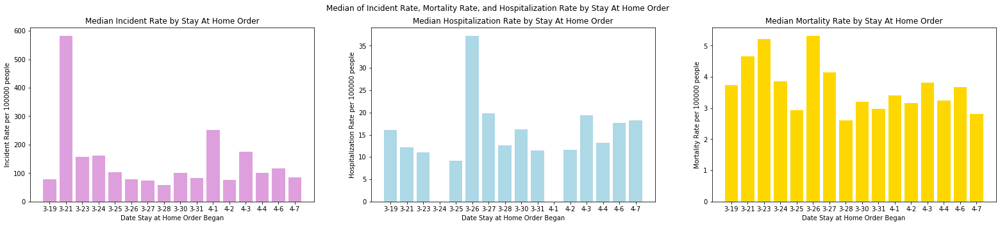

In [44]:
# Because their y axis each have their own range, we plotted each individual rate out to see if whether social distancing played an effect in decreasing that state's case. 
# Each subplot is the incident, hospitalization, and mortality rate respectively ordered by the SAH date.

def plot_median_subplots():
    
# subplots to separate
    fig = plt.figure(figsize = (27, 5))
    fig.suptitle("Median of Incident Rate, Mortality Rate, and Hospitalization Rate by Stay At Home Order")
    x = median_rates_SAH_date["SAH_dates"]
    month_date = [str(x.month) + "-" + str(x.day) for x in median_rates_SAH_date["SAH_dates"]]

    # incident rate
    just_incident_rate = median_rates_SAH_date[["Median Incident Rate", "SAH_dates"]]
    just_incident_rate["SAH_dates"] = month_date
    sub = fig.add_subplot(1, 3, 1)
    sub.bar(month_date, just_incident_rate["Median Incident Rate"], color = "plum")
    sub.set_title("Median Incident Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Incident Rate per 100000 people")

    # hospitalization rate
    just_hospitalization_rate = median_rates_SAH_date[["Median Hospitalization Rate", "SAH_dates"]]
    just_hospitalization_rate["SAH_dates"] = month_date
    sub = fig.add_subplot(1, 3, 2)
    sub.bar(month_date, just_hospitalization_rate ["Median Hospitalization Rate"], color = "lightblue")
    sub.set_title("Median Hospitalization Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Hospitalization Rate per 100000 people")

    #mortality rate
    just_mortality_rate = median_rates_SAH_date[["Median Mortality Rate", "SAH_dates"]]
    just_mortality_rate["SAH_dates"] = month_date
    sub = fig.add_subplot(1, 3, 3)
    sub.bar(month_date, just_mortality_rate ["Median Mortality Rate"], color = "gold")
    sub.set_title("Median Mortality Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Mortality Rate per 100000 people")

    plt.show()
    return just_incident_rate, just_hospitalization_rate, just_mortality_rate

just_incident_rate, just_hospitalization_rate, just_mortality_rate = plot_median_subplots()
    

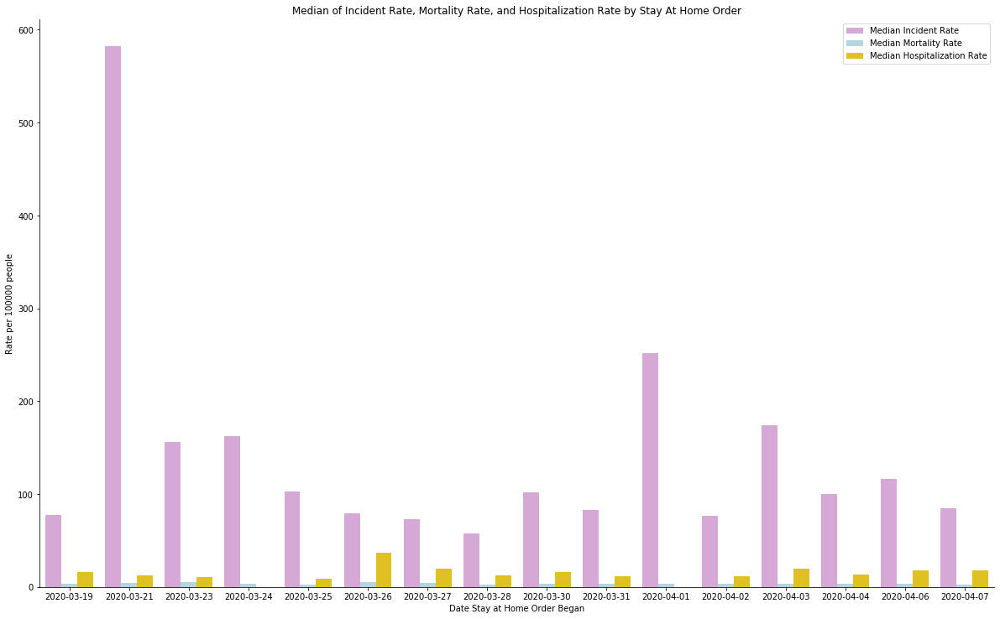

In [45]:
# Perhaps there is a correlation between all three rates, as maybe a higher incident rate results in higher hospitalization rate, ultimately resulting in a higher mortality rate. 
# One would assume that there should be a positive correlation between these three values. 
# To perhaps see this correlation, here is a barplot with all three values together. However, the two latter values (Mortality and Hospitalization) are slightly harder to see
# since their rates are much lower than incident rate. 

#plot all three on one plot
def plot_not_normalized_median():
    # NOT NORMALIZED
    ax = sns.catplot(x = "SAH_dates", y = "value", hue = "variable", data = median_rates_SAH_date_melted, kind = "bar", col_order = ["Median Incident Rate","Median Hospitalization Rate", "Median Mortality Rate"], legend = False, palette = sns.color_palette(["plum", "lightblue", "gold"]))
    ax.fig.subplots_adjust(top = 2.0, right = 3.3)
    plt.legend(loc='upper right')
    plt.title("Median of Incident Rate, Mortality Rate, and Hospitalization Rate by Stay At Home Order")
    plt.xlabel("Date Stay at Home Order Began")
    plt.ylabel("Rate per 100000 people")

    plt.show()
    return

plot_not_normalized_median()

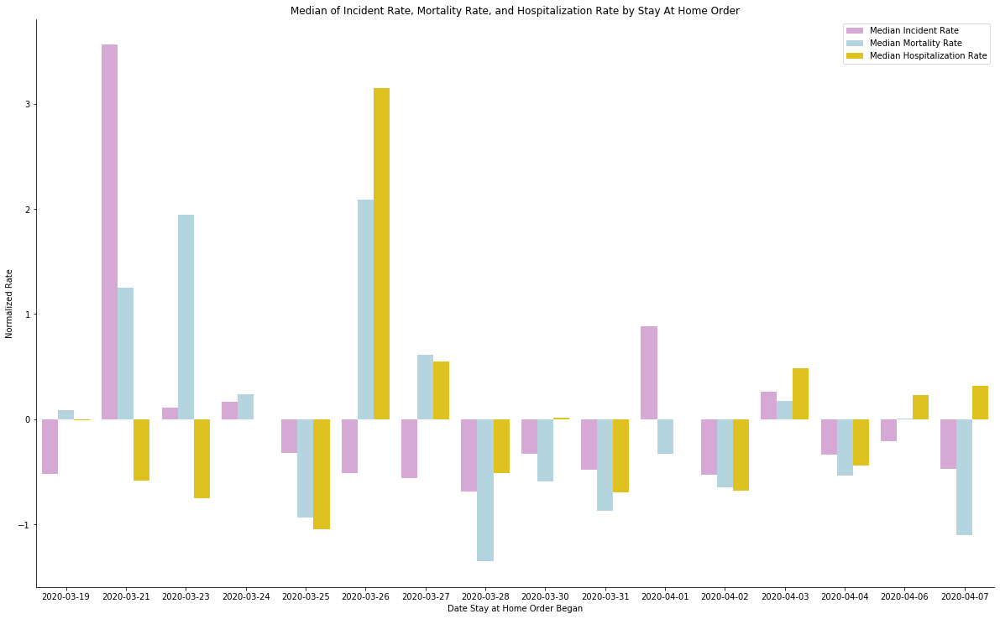

In [46]:
# To combat the differing y - values, normalization of each value seemed to be a viable option. After normalizing each rate, we can compare the rates slightly better in this
# fashion. However despite noramlization, it still seems quite difficult to interpret as to whether SAH orders helped or not. 

def plot_normalized_median():
    #plot all three on one plot
    ax = sns.catplot(x = "SAH_dates", y = "value", hue = "variable", data = median_rates_SAH_date_normalized_melted, kind = "bar", col_order = ["Median Incident Rate","Median Hospitalization Rate", "Median Mortality Rate"], legend = False, palette = sns.color_palette(["plum", "lightblue", "gold"]))
    ax.fig.subplots_adjust(top = 2.0, right = 3.3)
    plt.legend(loc='upper right')
    plt.title("Median of Incident Rate, Mortality Rate, and Hospitalization Rate by Stay At Home Order")
    plt.xlabel("Date Stay at Home Order Began")
    plt.ylabel("Normalized Rate")

    plt.show()
    return

plot_normalized_median()

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: htt

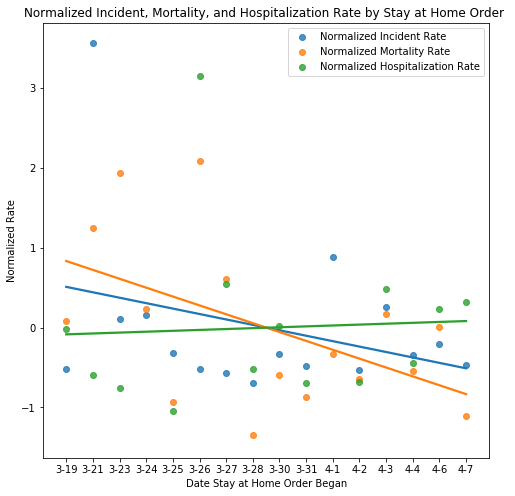

In [47]:
# Perhaps a barplot isn't quite telling of the data, but rather, a scatterplot with the line of best fit might give us a more general trend. We see that the later the SIP 
# date is, the mortality and incident rate seems to decrease. One argument for this is that if a state's COVID-19 cases aren't too bad, the state government and officials 
# won't issue a SAH order. That's not the way it should be approached, as people should SIP BEFORE the pandemic gets bad in their region, but Americans are Americans and 
# that is the way pretty much all states approached the SIP policy with the exception of California, the first state to issue such an order. 

def scatter_plot_median():
    just_incident_rate["Normalized"] = generate_norm_statistics(just_incident_rate["Median Incident Rate"])
    just_hospitalization_rate["Normalized"] = generate_norm_statistics(just_hospitalization_rate["Median Hospitalization Rate"])
    just_mortality_rate["Normalized"] = generate_norm_statistics(just_mortality_rate["Median Mortality Rate"])
    month_date = [str(x.month) + "-" + str(x.day) for x in median_rates_SAH_date["SAH_dates"]]

    x_vals = np.arange(len(just_incident_rate))

    plt.figure(figsize = (8, 8))
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_incident_rate, scatter = True, fit_reg = True, ci = None, label = "Normalized Incident Rate")
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_mortality_rate, scatter = True, fit_reg = True, ci = None, label = "Normalized Mortality Rate")
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_hospitalization_rate, scatter = True, fit_reg = True, ci = None, label = "Normalized Hospitalization Rate")

    plt.legend(loc='upper right')
    plt.xticks(x_vals)
    ax.set_xticklabels(month_date)

    plt.xlabel("Date Stay at Home Order Began")
    plt.ylabel("Normalized Rate")
    plt.title("Normalized Incident, Mortality, and Hospitalization Rate by Stay at Home Order ")
    
    plt.show()
    return

scatter_plot_median()


/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

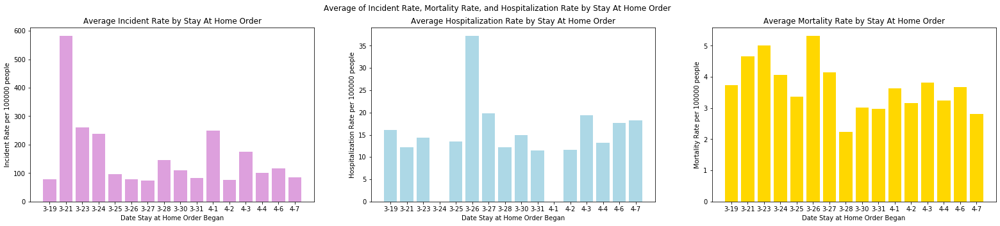

In [48]:
#look at average instead of median
def plot_average_subplots():
    fig = plt.figure(figsize = (27, 5))
    fig.suptitle("Average of Incident Rate, Mortality Rate, and Hospitalization Rate by Stay At Home Order")
    x = median_rates_SAH_date["SAH_dates"]
    month_date_avg = [str(x.month) + "-" + str(x.day) for x in avg_rates_SAH_date["SAH_dates"]]

    # incident rate
    just_incident_rate = avg_rates_SAH_date[["Avg Incident Rate", "SAH_dates"]]
    just_incident_rate["SAH_dates"] = month_date_avg
    sub = fig.add_subplot(1, 3, 1)
    sub.bar(month_date_avg, just_incident_rate["Avg Incident Rate"], color = "plum")
    sub.set_title("Average Incident Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Incident Rate per 100000 people")

    # hospitalization rate
    just_hospitalization_rate = avg_rates_SAH_date[["Avg Hospitalization Rate", "SAH_dates"]]
    just_hospitalization_rate["SAH_dates"] = month_date_avg
    sub = fig.add_subplot(1, 3, 2)
    sub.bar(month_date_avg, just_hospitalization_rate ["Avg Hospitalization Rate"], color = "lightblue")
    sub.set_title("Average Hospitalization Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Hospitalization Rate per 100000 people")

    #mortality rate
    just_mortality_rate = avg_rates_SAH_date[["Avg Mortality Rate", "SAH_dates"]]
    just_mortality_rate["SAH_dates"] = month_date_avg
    sub = fig.add_subplot(1, 3, 3)
    sub.bar(month_date_avg, just_mortality_rate ["Avg Mortality Rate"], color = "gold")
    sub.set_title("Average Mortality Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Mortality Rate per 100000 people")

    plt.show()
    return just_incident_rate, just_hospitalization_rate, just_mortality_rate

just_incident_rate_avg, just_hospitalization_rate_avg, just_mortality_rate_avg = plot_average_subplots()

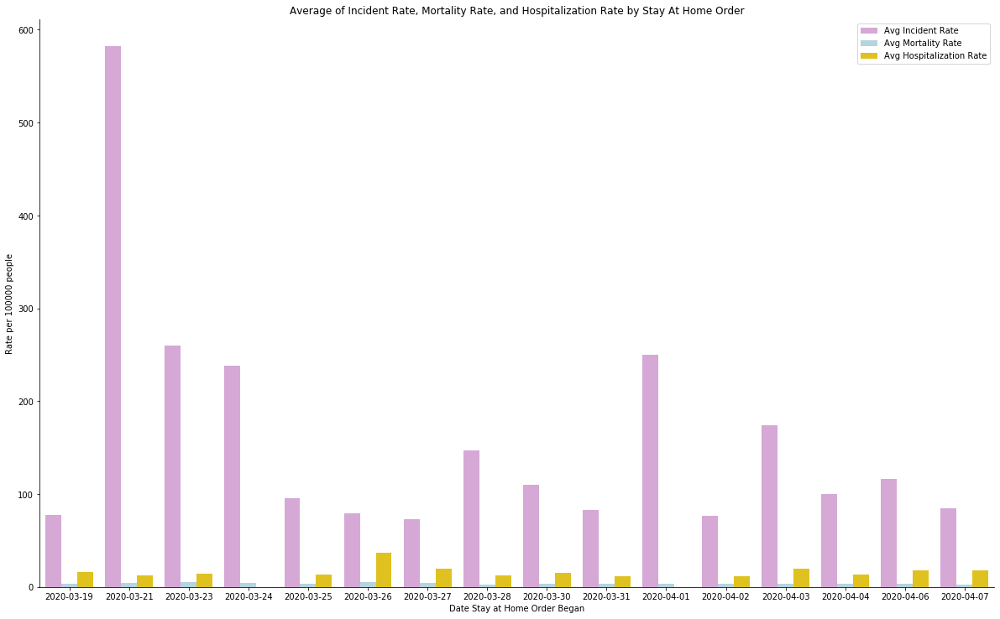

In [49]:
def plot_not_normalized_average():
    # NOT NORMALIZED
    ax = sns.catplot(x = "SAH_dates", y = "value", hue = "variable", data = avg_rates_SAH_date_melted, kind = "bar", col_order = ["Avg Incident Rate","Avg Hospitalization Rate", "Avg Mortality Rate"], legend = False, palette = sns.color_palette(["plum", "lightblue", "gold"]))
    ax.fig.subplots_adjust(top = 2.0, right = 3.3)
    plt.legend(loc='upper right')
    plt.title("Average of Incident Rate, Mortality Rate, and Hospitalization Rate by Stay At Home Order")
    plt.xlabel("Date Stay at Home Order Began")
    plt.ylabel("Rate per 100000 people")

    plt.show()
    return

plot_not_normalized_average()

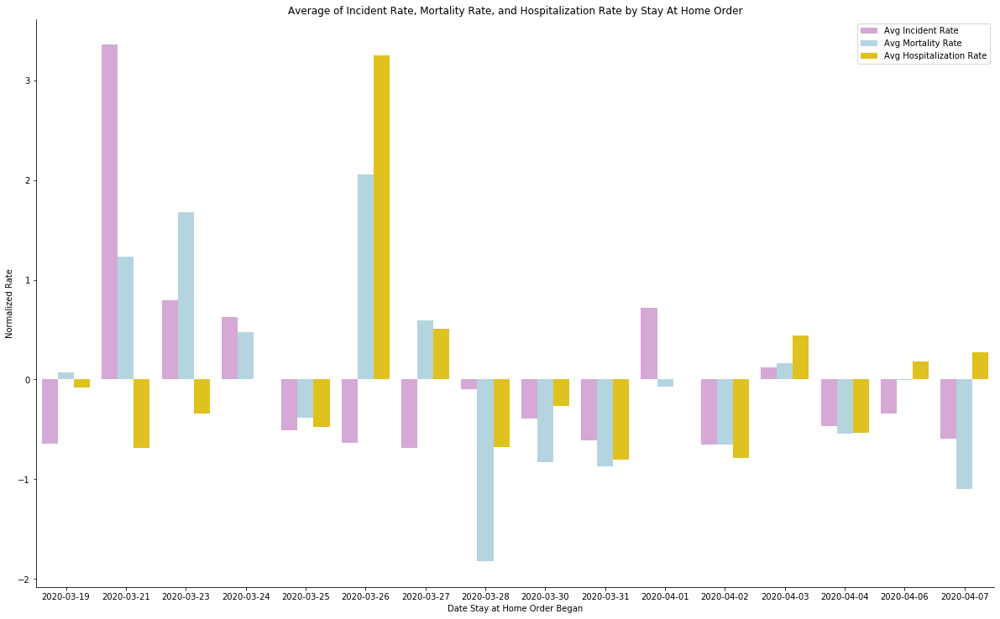

In [50]:
# plot all three on one plot

def plot_normalized_average():
    ax = sns.catplot(x = "SAH_dates", y = "value", hue = "variable", data = avg_rates_SAH_date_normalized_melted, kind = "bar", col_order = ["Avg Incident Rate","Avg Hospitalization Rate", "Avg Mortality Rate"], legend = False, palette = sns.color_palette(["plum", "lightblue", "gold"]))
    ax.fig.subplots_adjust(top = 2.0, right = 3.3)
    plt.legend(loc='upper right')
    plt.title("Average of Incident Rate, Mortality Rate, and Hospitalization Rate by Stay At Home Order")
    plt.xlabel("Date Stay at Home Order Began")
    plt.ylabel("Normalized Rate")

    plt.show()
    return 

plot_normalized_average()

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

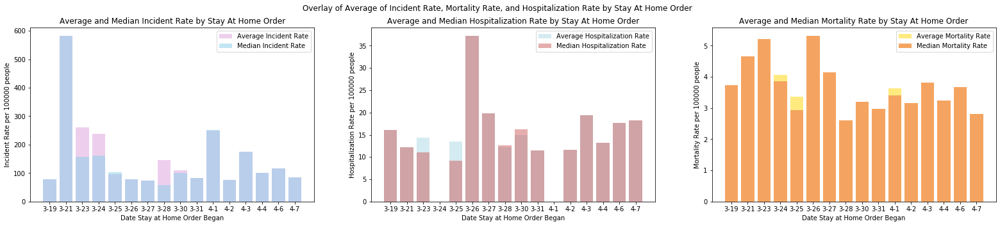

In [51]:
# It is hard to compare these two plots when you can't overlay them. Instead, we will overlay them and see if there is a significant difference. However, we see that the average
# and the median do not make too large of a difference. That makes sense to an extent because states generally have the same pattern if they decide to enforce SIP at that date.
# I would continue to overlay the the unnormalized/normalized plots, but given these subplots, we can already conclude that there isn't too much of a difference -- the other
# two plots would not add much (if a)

def plot_overlay_subplots():
    fig = plt.figure(figsize = (27, 5))
    fig.suptitle("Overlay of Average of Incident Rate, Mortality Rate, and Hospitalization Rate by Stay At Home Order")
    x = median_rates_SAH_date["SAH_dates"]
    month_date_avg = [str(x.month) + "-" + str(x.day) for x in avg_rates_SAH_date["SAH_dates"]]
    month_date_med = [str(x.month) + "-" + str(x.day) for x in median_rates_SAH_date["SAH_dates"]]

    # incident rate
    just_incident_rate_avg = avg_rates_SAH_date[["Avg Incident Rate", "SAH_dates"]]
    just_incident_rate_avg["SAH_dates"] = month_date_avg
    
    just_incident_rate_med = median_rates_SAH_date[["Median Incident Rate", "SAH_dates"]]
    just_incident_rate_med["SAH_dates"] = month_date_med
    
    sub = fig.add_subplot(1, 3, 1)
    sub.bar(month_date_avg, just_incident_rate_avg["Avg Incident Rate"], color = "plum", alpha = 0.5, label = "Average Incident Rate")
    sub.bar(month_date_med, just_incident_rate_med["Median Incident Rate"], color = "skyblue", alpha = 0.5, label = "Median Incident Rate")
    
    sub.set_title("Average and Median Incident Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Incident Rate per 100000 people")
    sub.legend()

    # hospitalization rate
    just_hospitalization_rate_avg = avg_rates_SAH_date[["Avg Hospitalization Rate", "SAH_dates"]]
    just_hospitalization_rate_avg["SAH_dates"] = month_date_avg
    
    just_hospitalization_rate_med = median_rates_SAH_date[["Median Hospitalization Rate", "SAH_dates"]]
    just_hospitalization_rate_med["SAH_dates"] = month_date_med
    
    sub = fig.add_subplot(1, 3, 2)
    sub.bar(month_date_avg, just_hospitalization_rate_avg["Avg Hospitalization Rate"], color = "lightblue", alpha = 0.5, label = "Average Hospitalization Rate")
    sub.bar(month_date_med, just_hospitalization_rate_med["Median Hospitalization Rate"], color = "indianred", alpha = 0.5, label = "Median Hospitalization Rate")
    
    sub.set_title("Average and Median Hospitalization Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Hospitalization Rate per 100000 people")
    sub.legend()
    
    #mortality rate
    just_mortality_rate_avg = avg_rates_SAH_date[["Avg Mortality Rate", "SAH_dates"]]
    just_mortality_rate_avg["SAH_dates"] = month_date_avg
    
    just_mortality_rate_med = median_rates_SAH_date[["Median Mortality Rate", "SAH_dates"]]
    just_mortality_rate_med["SAH_dates"] = month_date_med
    
    sub = fig.add_subplot(1, 3, 3)
    sub.bar(month_date_avg, just_mortality_rate_avg["Avg Mortality Rate"], color = "gold", alpha = 0.5, label = "Average Mortality Rate")
    sub.bar(month_date_med, just_mortality_rate_med["Median Mortality Rate"], color = "sandybrown", label = "Median Mortality Rate")
    
    sub.set_title("Average and Median Mortality Rate by Stay At Home Order")
    sub.set_xlabel("Date Stay at Home Order Began")
    sub.set_ylabel("Mortality Rate per 100000 people")
    sub.legend()
    
    return 

plot_overlay_subplots()

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: h

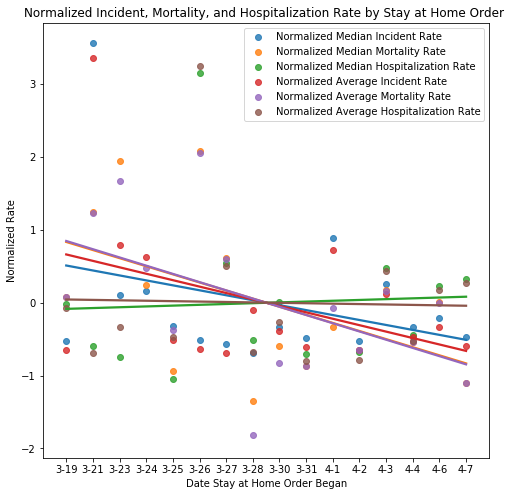

In [52]:
# Since the average and median rates don't show too large of a difference in a bar graph/it is hard to see the difference between the two, seeing LOBF for these might 
# be helpful, perhaps in a scatter plot. We will overlay the two and have LOBFs to see the general trend and see which one has a greater correlation. This is quite interesting
# since that the average of the rates seems to have a greater correlation. 

#just_incident_rate = median
#just_incident_rate_avg = average

def scatter_plot_overlay():
    just_incident_rate["Normalized"] = generate_norm_statistics(just_incident_rate["Median Incident Rate"])
    just_hospitalization_rate["Normalized"] = generate_norm_statistics(just_hospitalization_rate["Median Hospitalization Rate"])
    just_mortality_rate["Normalized"] = generate_norm_statistics(just_mortality_rate["Median Mortality Rate"])

    just_incident_rate_avg["Normalized"] = generate_norm_statistics(just_incident_rate_avg["Avg Incident Rate"])
    just_hospitalization_rate_avg["Normalized"] = generate_norm_statistics(just_hospitalization_rate_avg["Avg Hospitalization Rate"])
    just_mortality_rate_avg["Normalized"] = generate_norm_statistics(just_mortality_rate_avg["Avg Mortality Rate"])

    x_vals = np.arange(len(just_incident_rate))
    month_date = [str(x.month) + "-" + str(x.day) for x in avg_rates_SAH_date["SAH_dates"]]

    plt.figure(figsize = (8, 8))
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_incident_rate, scatter = True, fit_reg = True, ci = None, label = "Normalized Median Incident Rate")
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_mortality_rate, scatter = True, fit_reg = True, ci = None, label = "Normalized Median Mortality Rate")
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_hospitalization_rate, scatter = True, fit_reg = True, ci = None, label = "Normalized Median Hospitalization Rate")
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_incident_rate_avg, scatter = True, fit_reg = True, ci = None, label = "Normalized Average Incident Rate")
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_mortality_rate_avg, scatter = True, fit_reg = True, ci = None, label = "Normalized Average Mortality Rate")
    ax = sns.regplot(x = x_vals, y = "Normalized", data = just_hospitalization_rate_avg, scatter = True, fit_reg = True, ci = None, label = "Normalized Average Hospitalization Rate")
    

    plt.legend(loc='upper right')
    plt.xticks(x_vals)
    ax.set_xticklabels(month_date)

    plt.xlabel("Date Stay at Home Order Began")
    plt.ylabel("Normalized Rate")
    plt.title("Normalized Incident, Mortality, and Hospitalization Rate by Stay at Home Order ")
    
    plt.show()
    return

scatter_plot_overlay()

## Socioeconomic Study
Does socioeconomic status play a role in the ability to recover from COVID-19? If so, what role does it play?

In [53]:
# Wealth data seems to be outside the scope of the abridged dataset. 
# I recommend looking into this as possible additional research. Perhaps there is a correlation between wealth and rural / urban settings.
# data is now pulled from the CDC's SVI index.
# doesn't seem to play a role in number of deaths or confirmed or mortality rate.
# Infact SVI
full_stats = generate_clean_data()
county_svi = full_stats[['norm_deaths', 'norm_confirmed', 'SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme', 'SVIPercentileMLtheme', 'SVIPercentileHTtheme', 'mortality_rate', 'norm_mortality_rate', 'norm_growth_14_confirmed']]

county_svi_melt = pd.melt(county_svi, id_vars=['SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme', 'SVIPercentileMLtheme', 'SVIPercentileHTtheme'], value_vars=['norm_confirmed', 'norm_deaths'], value_name = 'Normalized Proportion')

def graph_mortality(column):
    norm_mortality = px.scatter(county_svi.dropna(), x=column, y='norm_mortality_rate', trendline = 'ols')
    norm_mortality.update_layout(title='COVID19 Normalized Mortality Rate vs ' + column)
    norm_mortality.show()
    
def graph_cases(column):
    fig = px.scatter(county_svi_melt.dropna(), x=column, y='Normalized Proportion', color='variable', trendline = 'ols')
    fig.update_layout(title='COVID19 Cases and Deaths vs ' + column)
    format_graph(fig).show()
    
def graph_growth(column):
    norm_growth = px.scatter(county_svi.dropna(), x=column, y='norm_growth_14_confirmed', trendline = 'ols')
    norm_growth.update_layout(title='COVID19 Normalized 14 Day Growth Rate vs ' + column)
    norm_growth.show()

svi_columns = ['SVIPercentile', 'SVIPercentileSEtheme'] #, 'SVIPercentileHDtheme', 'SVIPercentileMLtheme', 'SVIPercentileHTtheme'] Feel free to add these back if you are interested but that wasn't part of our research questions.
for column in svi_columns:
    graph_mortality(column)
    #graph_cases(column)
    graph_growth(column)

print(len(county_svi_melt) - county_svi_melt.count())

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



SVIPercentile            2
SVIPercentileSEtheme     2
SVIPercentileHDtheme     0
SVIPercentileMLtheme     0
SVIPercentileHTtheme     0
variable                 0
Normalized Proportion    0
dtype: int64


## Medicare Study
Yet another bonus study we don't have space to write about.

In [54]:
# There doesn't seem to be much of a correlation. However, the selectKBest model seems to favor this.
full_stats = generate_clean_data()
county_medicare = full_stats[['mortality_rate', 'norm_deaths', 'norm_confirmed', 'MedicareEnrollment,AgedTot2017', 'PopTotalMale2017', 'PopTotalFemale2017']]
county_medicare['prop_medicare'] = county_medicare['MedicareEnrollment,AgedTot2017'] / (county_medicare['PopTotalMale2017'] + county_medicare['PopTotalFemale2017'])
county_medicare = county_medicare.dropna()
county_medicare_melt = pd.melt(county_medicare, id_vars=['prop_medicare'], value_vars=['norm_confirmed', 'norm_deaths'], value_name = 'Normalized Proportion')

# Mortality Rate
fig = px.scatter(county_medicare, x='prop_medicare', y='mortality_rate', trendline = 'ols')
fig.update_layout(title='COVID19 Cases and Deaths vs Medicare Enrollment')
fig.show()
print(len(county_medicare_melt) - county_medicare_melt.count())

# Prop confirmed and dead
fig2 = px.scatter(county_medicare_melt, x='prop_medicare', y='Normalized Proportion', color = 'variable', trendline = 'ols')
fig2.update_layout(title='COVID19 Cases and Deaths vs Medicare Enrollment')
fig2.show()

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



prop_medicare            0
variable                 0
Normalized Proportion    0
dtype: int64


## Model Generation

In [55]:
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.multioutput import MultiOutputRegressor
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_absolute_error

Here we generate out train test splits.
In particular, we are electing to eliminate almost all of the timeseries data from the features that we have access to. The reason being that we aren't trying to evaluate how many cases will occur based upon past case trends but rather through the other factors such as social distancing, population density etc.

In [56]:
full_stats = generate_clean_data(limited=True)
y_columns_pre_process = ['4/18/20_deaths', '4/18/20_confirmed', 'incident_rate', 'mortality_rate', 'norm_incident_rate', 'norm_mortality_rate', 'growth_14_confirmed', 'growth_31_confirmed', 'growth_14_31_confirmed', 'growth_14_deaths', 'growth_31_deaths', 'growth_14_31_deaths', 'norm_growth_14_confirmed', 'norm_growth_31_confirmed', 'norm_growth_14_31_confirmed', 'norm_growth_14_deaths', 'norm_growth_31_deaths', 'norm_growth_14_31_deaths']
y_columns = ['norm_incident_rate', 'norm_growth_14_confirmed', 'norm_growth_31_confirmed']

def process_data(X, y, columns):
    """ Processes the data. Selecting out the desired X columns."""
    X = X[columns]
    if 'PopulationDensityperSqMile2010' in columns:
        X['log_pop_density'] = np.log(X['PopulationDensityperSqMile2010'] + 1)
    if 'Rural-UrbanContinuumCode2013' in X.columns:
        X = ohe_counties(X, ['Rural-UrbanContinuumCode2013'])
    return X.fillna(0), y

def process_drop_data(X, y, columns):
    """ Processes the data. Dropping the undesired X columns and processing the y vector."""
    X = X.copy()
    X = X.drop(columns, axis=1)
    if 'PopulationDensityperSqMile2010' in columns:
        X['log_pop_density'] = np.log(X['PopulationDensityperSqMile2010'] + 1)
    if 'Rural-UrbanContinuumCode2013' in X.columns:
        X = ohe_counties(X, ['Rural-UrbanContinuumCode2013'])
    return X.fillna(0), y

def process_y_vector(y):
    """ Processes the y vector, specifically calculating growth rates and removing 3/18/20 data.
    """
    y = y[y_columns]
    return y

def remove_mortality(y):
    """ Drops the mortality columns from the y vector. These columns contain NaN values that need to be dropped if mortality is to be modeled. """
    return y.drop(['mortality_rate', 'norm_mortality_rate'], axis=1, errors='ignore')

def keep_mortality(y):
    """ Keeps the mortality columns and drops everything else."""
    return y[['mortality_rate', 'norm_mortality_rate']]

X_train_raw, X_test_raw, y_train_raw, y_test_raw = train_test_split(full_stats.drop(y_columns_pre_process, axis = 1), full_stats[y_columns_pre_process], test_size=0.2, random_state=42)
y_train_raw = process_y_vector(remove_mortality(y_train_raw))
y_test_raw = process_y_vector(remove_mortality(y_test_raw))

full_stats_mortality = full_stats[~full_stats['mortality_rate'].isna()]
X_train_raw_mortality, X_test_raw_mortality, y_train_raw_mortality, y_test_raw_mortality = train_test_split(full_stats_mortality.drop(y_columns_pre_process, axis = 1), full_stats_mortality[y_columns_pre_process], test_size=0.2, random_state=42)
y_train_raw_mortality = keep_mortality(y_train_raw_mortality)
y_test_raw_mortality = keep_mortality(y_test_raw_mortality)

SCORER = 'neg_mean_absolute_error'

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Model #1: The baseline model
This is a naive baseline model that simply takes case numbers from 3/18/20 as features.
We will use this as a blind guess baseline. We hope to produce models that can best this one.

Upon retrospection, this model suffers from overfitting (0.19 vs 0.065 train test scores using r^2 [variance_weighted if using 0.22, uniform_average if using 0.23 of sklearn])

The mortality model does even worse (almost just blind guessing). But lets put the mortality model on hold for now.

In [57]:
def baseline():
    ''' Calculates the Baseline Model. '''
    baseline_model = LinearRegression(normalize=True)
    baseline_columns = ['3/18/20_deaths', '3/18/20_confirmed']
    baseline_X_train, baseline_y_train = process_data(X_train_raw, y_train_raw, baseline_columns)
    # This line of code (the test set) is added as a final evalution but should not be run until models are finalized.
    baseline_X_test, baseline_y_test = process_data(X_test_raw, y_test_raw, baseline_columns)

    baseline_score = cross_val_score(baseline_model, baseline_X_train, baseline_y_train, cv=5, scoring = SCORER)
    print(baseline_score)

    baseline_model = baseline_model.fit(baseline_X_train, baseline_y_train)
    print(baseline_X_train.columns)
    # Loss. Lower is better.
    print(mean_absolute_error(baseline_y_train, baseline_model.predict(baseline_X_train)))
    print(mean_absolute_error(baseline_y_test, baseline_model.predict(baseline_X_test)))
    print(baseline_y_train.columns)
    print(baseline_model.coef_)
    return baseline_score
    
def compare_scores(score):
    """ Compares the score to the baseline score. """
    return np.mean(score - baseline_score)
    
baseline_score = baseline()

[-0.3506967  -0.39678025 -0.40905773 -0.33475899 -0.37080384]
Index(['3/18/20_deaths', '3/18/20_confirmed'], dtype='object')
0.3664296505233054
0.3595851861491916
Index(['norm_incident_rate', 'norm_growth_14_confirmed',
       'norm_growth_31_confirmed'],
      dtype='object')
[[-0.18530615  0.02064644]
 [-0.00225593 -0.00025888]
 [-0.00472079 -0.00039808]]


In [58]:
# If we didnt remove mortality.
baseline_model_mortality = LinearRegression(normalize=True)
baseline_columns = ['3/18/20_deaths', '3/18/20_confirmed']
baseline_X_train_mortality, baseline_y_train_mortality = process_data(X_train_raw_mortality, y_train_raw_mortality, baseline_columns)
# This line of code (the test set) is added as a final evalution but should not be run until models are finalized.
baseline_X_test_mortality, baseline_y_test_mortality = process_data(X_test_raw_mortality, y_test_raw_mortality, baseline_columns)

baseline_score_mortality = cross_val_score(baseline_model_mortality, baseline_X_train_mortality, baseline_y_train_mortality, cv=5, scoring = SCORER)
print(baseline_score_mortality)

baseline_model_mortality = baseline_model_mortality.fit(baseline_X_train_mortality, baseline_y_train_mortality)
print(baseline_X_train_mortality.columns)
# Loss. Lower is better.
print(mean_absolute_error(baseline_y_train_mortality, baseline_model_mortality.predict(baseline_X_train_mortality)))
print(mean_absolute_error(baseline_y_test_mortality, baseline_model_mortality.predict(baseline_X_test_mortality)))
print(baseline_y_train_mortality.columns)
baseline_model_mortality.coef_

[-1.98109742 -2.2771742  -2.25838762 -1.99971616 -2.00501434]
Index(['3/18/20_deaths', '3/18/20_confirmed'], dtype='object')
2.0956552486922906
2.5703894703297223
Index(['mortality_rate', 'norm_mortality_rate'], dtype='object')


array([[0.0515929 , 0.00349462],
       [0.00694875, 0.00047067]])

## Model #2: Linear Regression using only features in our EDA / Questions
Namely, we will use the following features: 'SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme', 'SVIPercentileMLtheme', 'SVIPercentileHTtheme', 'Rural-UrbanContinuumCode2013', 'PopulationDensityperSqMile2010', 'stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym'

By mean absolute error, this model does just slightly better. But also still very disappointing.

In [59]:
target_features_model = LinearRegression(normalize=True)
target_features_wealth = ['SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme', 'SVIPercentileMLtheme', 'SVIPercentileHTtheme']
target_features_urban = ['Rural-UrbanContinuumCode2013', 'PopulationDensityperSqMile2010']
target_features_sd = ['stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym']
target_features = target_features_wealth + target_features_urban + target_features_sd

target_features_X_train, target_features_y_train = process_data(X_train_raw, y_train_raw, target_features)
# This line of code (the test set) is added as a final evalution but should not be run until models are finalized.
target_features_X_test, target_features_y_test = process_data(X_test_raw, y_test_raw, target_features)

target_features_score = cross_val_score(target_features_model, target_features_X_train, target_features_y_train, cv=5, scoring = SCORER)
print(target_features_score)
print(compare_scores(target_features_score))

target_features_model = target_features_model.fit(target_features_X_train, target_features_y_train)
print(target_features_X_train.columns)
# Loss. Lower is better.
print(mean_absolute_error(target_features_y_train, target_features_model.predict(target_features_X_train)))
print(mean_absolute_error(target_features_y_test, target_features_model.predict(target_features_X_test)))
print(target_features_y_train.columns)
print(target_features_model.coef_)

[-0.35772595 -0.3787454  -0.38826602 -0.33207948 -0.36297104]
0.008461923443289809
Index(['SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme',
       'SVIPercentileMLtheme', 'SVIPercentileHTtheme',
       'PopulationDensityperSqMile2010', 'stay at home', '>50 gatherings',
       '>500 gatherings', 'public schools', 'restaurant dine-in',
       'entertainment/gym', 'log_pop_density',
       'Rural-UrbanContinuumCode2013_1.0', 'Rural-UrbanContinuumCode2013_2.0',
       'Rural-UrbanContinuumCode2013_3.0', 'Rural-UrbanContinuumCode2013_4.0',
       'Rural-UrbanContinuumCode2013_5.0', 'Rural-UrbanContinuumCode2013_6.0',
       'Rural-UrbanContinuumCode2013_7.0', 'Rural-UrbanContinuumCode2013_8.0',
       'Rural-UrbanContinuumCode2013_9.0'],
      dtype='object')
0.35582853867027003
0.35521469642758347
Index(['norm_incident_rate', 'norm_growth_14_confirmed',
       'norm_growth_31_confirmed'],
      dtype='object')
[[ 2.70155917e-03  1.33932872e-01  1.04010319e-02  2.02414503e-01

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Model 2 Varients
Lets try breaking it down into smaller components.

SVI does a fair job.
Urban seems to do the best
Social Distancing is not doing too well...

Against the baseline, only Urban really does any better.

In [60]:
def model(columns, test=False):
    """ Models the passed in columns with a linear regression.
    """
    target_model = LinearRegression(normalize=True)

    target_X_train, target_y_train = process_data(X_train_raw, y_train_raw, columns)
    # This line of code (the test set) is added as a final evalution but should not be run until models are finalized.
    if test:
        target_X_test, target_y_test = process_data(X_test_raw, y_test_raw, columns)

    target_score = cross_val_score(target_model, target_X_train, target_y_train, cv=5, scoring = SCORER)
    print("Cross Validation Score:", target_score)
    print("Compared against baseline score:", compare_scores(target_score))

    target_model = target_model.fit(target_X_train, target_y_train)
    if VERBOSE:
        print(target_X_train.columns)
    # Loss. Lower is better.
    print("Training Loss:", mean_absolute_error(target_y_train, target_model.predict(target_X_train)))
    if test:
        print("Testing Loss:", mean_absolute_error(target_y_test, target_model.predict(target_X_test)))
    if VERBOSE:
        print(target_y_train.columns)
        print(target_model.coef_)


In [61]:
# set test to true when you are ready to test the final models.
test = True
model(target_features_wealth, test)
model(target_features_urban, test)
model(target_features_sd, test)

Cross Validation Score: [-0.36022882 -0.39041333 -0.3937285  -0.3450577  -0.38047351]
Compared against baseline score: -0.001560870051606955
Index(['SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme',
       'SVIPercentileMLtheme', 'SVIPercentileHTtheme'],
      dtype='object')
Training Loss: 0.371936412085437
Testing Loss: 0.36325729490249087
Index(['norm_incident_rate', 'norm_growth_14_confirmed',
       'norm_growth_31_confirmed'],
      dtype='object')
[[-0.89959954  0.45366347 -0.05954429  0.75086063  0.53643513]
 [ 0.61397501  0.1757411  -0.29836211 -0.34772901 -0.27659505]
 [ 0.06898316 -0.19997753  0.04874392  0.27005815  0.32635597]]
Cross Validation Score: [-0.34262647 -0.37139864 -0.38640365 -0.32700578 -0.36179865]
Compared against baseline score: 0.014572864163976318
Index(['PopulationDensityperSqMile2010', 'log_pop_density',
       'Rural-UrbanContinuumCode2013_1.0', 'Rural-UrbanContinuumCode2013_2.0',
       'Rural-UrbanContinuumCode2013_3.0', 'Rural-UrbanCon

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Okay, so maybe let us focus only one 1 feature for the y_vector: `norm_growth_14_confirmed`, the 14 day growth proportion

In [62]:
target_column = 'norm_growth_14_confirmed'
y_train_raw = y_train_raw[[target_column]]
y_test_raw = y_test_raw[[target_column]]
y_columns = target_column

In [63]:
# Once again results are quite mixed. Lets see if we can do better with another model...
baseline_score = baseline()
model(target_features_wealth, test)
model(target_features_urban, test)
model(target_features_sd, test)

[-0.28534291 -0.32827325 -0.3082764  -0.2326697  -0.28107442]
Index(['3/18/20_deaths', '3/18/20_confirmed'], dtype='object')
0.284870991920077
0.3039464348426766
Index(['norm_growth_14_confirmed'], dtype='object')
[[-0.00225593 -0.00025888]]
Cross Validation Score: [-0.29257561 -0.31717531 -0.29547502 -0.23155361 -0.27759208]
Compared against baseline score: 0.0042530105567288035
Index(['SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme',
       'SVIPercentileMLtheme', 'SVIPercentileHTtheme'],
      dtype='object')
Training Loss: 0.28086716204577855
Testing Loss: 0.30494913107487237
Index(['norm_growth_14_confirmed'], dtype='object')
[[ 0.61397501  0.1757411  -0.29836211 -0.34772901 -0.27659505]]
Cross Validation Score: [-0.28860806 -0.33197188 -0.3050694  -0.22944428 -0.28452245]
Compared against baseline score: -0.0007958773633077343
Index(['PopulationDensityperSqMile2010', 'log_pop_density',
       'Rural-UrbanContinuumCode2013_1.0', 'Rural-UrbanContinuumCode2013_2.0',
 

/srv/conda/envs/data100/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Model #3, SelectKBest filter on a Linear Regressor.
Can we select better features? Perhaps we just weren't studying the proper features.

In [64]:
# columns = ['3/18/20_deaths', '3/18/20_confirmed', '3/25/20_deaths', '3/25/20_confirmed', 'Rural-UrbanContinuumCode2013', 'stay at home', '>50 gatherings', '>500 gatherings', 'public schools', 'restaurant dine-in', 'entertainment/gym', 'SVIPercentile', 'SVIPercentileSEtheme', 'SVIPercentileHDtheme', 'SVIPercentileMLtheme', 'SVIPercentileHTtheme', 'PopulationEstimate65+2017', 'PopulationDensityperSqMile2010', 'dem_to_rep_ratio',  'DiabetesPercentage', 'HeartDiseaseMortality', 'StrokeMortality', 'Smokers_Percentage', 'RespMortalityRate2014', '#FTEHospitalTotal2017', "TotalM.D.'s,TotNon-FedandFed2017", '#Hospitals', '#ICU_beds']

column_drops = ['countyFIPS', 'FIPS', 'CountyName', 'CensusRegionName', 'CensusDivisionName', 'StateFull', 'stay at home_ts', '>50 gatherings_ts', '>500 gatherings_ts', 'public schools_ts', 'restaurant dine-in_ts', 'entertainment/gym_ts', 'federal guidelines_ts', 'foreign travel ban_ts', 'federal guidelines', 'foreign travel ban', 'STATEFP', 'lat', 'lon', 'POP_LATITUDE', 'POP_LONGITUDE']
column_drops += ['4/4/20_deaths', '4/4/20_confirmed', '4/1/20_deaths', '4/1/20_confirmed', 'prop_deaths', 'prop_confirmed', 'norm_deaths', 'norm_confirmed']

X_train, y_train = process_drop_data(X_train_raw, y_train_raw, column_drops)
X_test, y_test = process_drop_data(X_test_raw, y_test_raw, column_drops)
y_train = y_train[target_column]

In [65]:
# Lets test out a naive SelectKBest model looking fo 10 best features.
skb = SelectKBest(f_regression, k=10)
X_train_new = skb.fit_transform(X_train, y_train)

In [66]:
# These are the columns it selected.
X_train.columns[skb.get_support()]

Index(['DiabetesPercentage', 'HeartDiseaseMortality', 'Smokers_Percentage',
       'RespMortalityRate2014', '#HospParticipatinginNetwork2017',
       '#Hospitals', 'SVIPercentile', 'SVIPercentileSEtheme',
       'Rural-UrbanContinuumCode2013_1.0', 'Rural-UrbanContinuumCode2013_5.0'],
      dtype='object')

In [67]:
# Lets check to see if any columns weren't processed by the model
X_train.columns[pd.Series(skb.scores_).isnull()]

Index([], dtype='object')

In [68]:
# Okay let us put the features into a linear model and see how it does. Yeah it didn't do too well...
lin_model = LinearRegression(normalize=True)
pipeline = Pipeline([('skb_filter', SelectKBest(f_regression, k=20)), ('LinModel', lin_model)])

y_train_skb = y_train
print(compare_scores(cross_val_score(pipeline, X_train, y_train_skb, cv=5, scoring = SCORER)))
print(X_train.columns)
pipeline = pipeline.fit(X_train, y_train_skb)
print(pipeline.score(X_train, y_train_skb))
print(pipeline['LinModel'].coef_)
print(X_train.columns[pipeline['skb_filter'].get_support()])

-0.004052474778000298
Index(['PopulationEstimate2018', 'PopTotalMale2017', 'PopTotalFemale2017',
       'FracMale2017', 'PopulationEstimate65+2017',
       'PopulationDensityperSqMile2010', 'CensusPopulation2010',
       'MedianAge2010', '#EligibleforMedicare2018',
       'MedicareEnrollment,AgedTot2017', '3-YrDiabetes2015-17',
       'DiabetesPercentage', 'HeartDiseaseMortality', 'StrokeMortality',
       'Smokers_Percentage', 'RespMortalityRate2014', '#FTEHospitalTotal2017',
       'TotalM.D.'s,TotNon-FedandFed2017', '#HospParticipatinginNetwork2017',
       '#Hospitals', '#ICU_beds', 'dem_to_rep_ratio', 'PopMale<52010',
       'PopFmle<52010', 'PopMale5-92010', 'PopFmle5-92010', 'PopMale10-142010',
       'PopFmle10-142010', 'PopMale15-192010', 'PopFmle15-192010',
       'PopMale20-242010', 'PopFmle20-242010', 'PopMale25-292010',
       'PopFmle25-292010', 'PopMale30-342010', 'PopFmle30-342010',
       'PopMale35-442010', 'PopFmle35-442010', 'PopMale45-542010',
       'PopFmle45-542

In [69]:
# Lets make it even better by putting it into a GridSearchCV. It kinda? does better but not really.
param_grid = {
    'skb_filter__k': np.linspace(1, 30, num = 20, dtype=int),
}
search = GridSearchCV(pipeline, param_grid, scoring=SCORER, error_score = 'raise')
search.fit(X_train, y_train_skb)
print("Best parameter (CV score=%0.3f):" % search.best_score_)
print(search.best_params_)
print(X_train.columns[search.best_estimator_['skb_filter'].get_support()])
if test:
    print(mean_absolute_error(y_test, search.best_estimator_.predict(X_test)))

Best parameter (CV score=-0.282):
{'skb_filter__k': 2}
Index(['RespMortalityRate2014', 'SVIPercentileSEtheme'], dtype='object')
0.29713351869115356


In [70]:
if VERBOSE:
    print(search.cv_results_)

{'mean_fit_time': array([0.00951047, 0.00798941, 0.00746951, 0.00799813, 0.00761619,
       0.00760918, 0.00743246, 0.00739045, 0.00747705, 0.01095572,
       0.00904922, 0.00843277, 0.00872412, 0.01318707, 0.01120043,
       0.00832691, 0.00903769, 0.00882778, 0.00833397, 0.00895042]), 'std_fit_time': array([1.39967769e-03, 5.15969248e-04, 4.01507636e-04, 3.59270159e-04,
       1.62064148e-04, 1.25554619e-04, 6.36357008e-05, 1.58099989e-04,
       3.73363738e-04, 2.73399668e-03, 1.18574065e-03, 1.55603195e-04,
       5.79014402e-04, 4.84654852e-03, 2.33601389e-03, 3.85833240e-04,
       2.96566738e-04, 4.24427571e-04, 2.74665463e-04, 7.45942375e-04]), 'mean_score_time': array([0.00245533, 0.00186505, 0.00186877, 0.00185003, 0.00170636,
       0.00177007, 0.00176268, 0.00169239, 0.00170026, 0.0029284 ,
       0.00205665, 0.00181289, 0.00186691, 0.00335956, 0.00235667,
       0.00184517, 0.00211458, 0.00214429, 0.00178981, 0.00187302]), 'std_score_time': array([4.12631954e-04, 7.6564309